#  New York City Airbnb Prices Project - [50]

### Nureddin Kamadan
### Talha Balin
### Ihsan Sabri Yesilyurt

## Machine Learning

In this part we utilized three different machine learning methods namely Linear, KNN and Decision tree for regression

In [ ]:
from google.colab import drive
drive.mount("./drive", force_remount=True)
import pandas as pd  # an alias for pandas
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px #for heatmap
import seaborn as sns
import scipy.stats as stats
from statsmodels.formula.api import ols
import statsmodels.api as sm


!pip install bioinfokit
from bioinfokit.analys import stat


from numpy import cos, sin, arcsin, sqrt
from math import radians

from os.path import join

# displaying option
pd.set_option('max_rows', 50)
%matplotlib inline

path_prefix = "./drive/My Drive"

Mounted at ./drive


/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



     |████████████████████████████████| 92kB 6.1MB/s 
  Created wheel for bioinfokit: filename=bioinfokit-2.0.4-cp37-none-any.whl size=56008 sha256=dc1b63d62359d90d08e7cc48e3047be430e0267bc94c2948cec9c539d01f3b67
  Stored in directory: /root/.cache/pip/wheels/43/cf/aa/4a4fe54a3edb663ee7bd9b245bd946506c8bd4b99f4ae00507
  Created wheel for adjustText: filename=adjustText-0.7.3-cp37-none-any.whl size=7100 sha256=4d2c7cdcea565c5425c08d866d8b622b6003f977388e870751f71252a583e599
  Stored in directory: /root/.cache/pip/wheels/41/95/74/7d347e136d672f8bc28e937032bc92baf4f80856763a7e7b72
Successfully built bioinfokit adjustText


In [ ]:
#Burada df_c_kaggle ı yeniden import edebiliriz...
# df_c_kaggle = pd.read_csv("df_c_kaggle.csv")
df_c_kaggle = pd.read_csv(join(path_prefix, "df_c_kaggle.csv"))

df_c_kaggle.head()

,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.210000,6,365,108,0.465043,28,1.554023,374,483
1,1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.380000,2,355,59,0.093298,21,0.516611,2068,3243
2,2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,1.373221,1,365,168,0.586601,16,0.621381,2204,3230
3,3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.640000,1,194,69,0.417059,27,1.772545,1242,1188
4,4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.100000,1,0,449,0.388443,16,0.560944,2342,3105


In [ ]:
mean = df_c_kaggle['price'].mean()
std = df_c_kaggle['price'].std()
upper_limit = mean + 3 * std
df_c_kaggle = df_c_kaggle[df_c_kaggle['price'] <= upper_limit]

In [ ]:
df_ml_kaggle = df_c_kaggle.copy()
df_ml_kaggle.head()

,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.210000,6,365,108,0.465043,28,1.554023,374,483
1,1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.380000,2,355,59,0.093298,21,0.516611,2068,3243
2,2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,1.373221,1,365,168,0.586601,16,0.621381,2204,3230
3,3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.640000,1,194,69,0.417059,27,1.772545,1242,1188
4,4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.100000,1,0,449,0.388443,16,0.560944,2342,3105


In [ ]:
print("Number of NaN values for 'last_review': ",df_ml_kaggle[df_ml_kaggle["last_review"].isna()]["id"].count())
#So we can drop "last_review" ? 
df_ml_kaggle.drop(["last_review"],axis=1,inplace = True)
df_ml_kaggle.head()

Number of NaN values for 'last_review':  9860


,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,0.210000,6,365,108,0.465043,28,1.554023,374,483
1,1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,0.380000,2,355,59,0.093298,21,0.516611,2068,3243
2,2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,1.373221,1,365,168,0.586601,16,0.621381,2204,3230
3,3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,4.640000,1,194,69,0.417059,27,1.772545,1242,1188
4,4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,0.100000,1,0,449,0.388443,16,0.560944,2342,3105


We looked whether we can use the feature "last_review".Since number of NaN values in "last_review" is almost 10000, we can drop it.

In [ ]:
#We will use these encoders...
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
onehot = preprocessing.OneHotEncoder()

We used LabelEncoder to encode our string paramters into double values. That is necessary because we cannot use any string in our models.

In [ ]:
#Preprocess here
df_ml_kaggle.drop(["name","Unnamed: 0","host_name"],axis=1, inplace = True)
df_ml_kaggle["Price"] = df_ml_kaggle["price"]
df_ml_kaggle.drop(["price"],axis=1,inplace=True)  #We did this to put out target value "Price" at the end of our DataFrame...
#a = onehot.fit(df_ml_kaggle["neighbourhood_group"].values.reshape(-1,1))
df_ml_kaggle.head()

,id,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies,Price
0,2539,2787,Brooklyn,Kensington,40.64749,-73.97237,Private room,1,9,0.210000,6,365,108,0.465043,28,1.554023,374,483,149
1,2595,2845,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,1,45,0.380000,2,355,59,0.093298,21,0.516611,2068,3243,225
2,3647,4632,Manhattan,Harlem,40.80902,-73.94190,Private room,3,0,1.373221,1,365,168,0.586601,16,0.621381,2204,3230,150
3,3831,4869,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,1,270,4.640000,1,194,69,0.417059,27,1.772545,1242,1188,89
4,5022,7192,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,10,9,0.100000,1,0,449,0.388443,16,0.560944,2342,3105,80


We excluded the unnecessary features such as "name", "host_name" etc. as we will not use them.

In [ ]:
df_ml_kaggle1 = df_ml_kaggle.copy()
df_ml_kaggle1.drop(["id","host_id","latitude","longitude",],axis=1,inplace = True)
df_ml_kaggle1.head()

,neighbourhood_group,neighbourhood,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies,Price
0,Brooklyn,Kensington,Private room,1,9,0.210000,6,365,108,0.465043,28,1.554023,374,483,149
1,Manhattan,Midtown,Entire home/apt,1,45,0.380000,2,355,59,0.093298,21,0.516611,2068,3243,225
2,Manhattan,Harlem,Private room,3,0,1.373221,1,365,168,0.586601,16,0.621381,2204,3230,150
3,Brooklyn,Clinton Hill,Entire home/apt,1,270,4.640000,1,194,69,0.417059,27,1.772545,1242,1188,89
4,Manhattan,East Harlem,Entire home/apt,10,9,0.100000,1,0,449,0.388443,16,0.560944,2342,3105,80


We also excluded the "id", "host_id", "latitude" and "longitude" parameters as they will neither help us improve the regression model.

In [ ]:
tmp = pd.DataFrame(df_ml_kaggle1,columns = ["neighbourhood_group","neighbourhood","room_type"])
tmp = tmp.apply(le.fit_transform)
df_ml_kaggle1["neighbourhood_group"] = tmp["neighbourhood_group"]
df_ml_kaggle1["neighbourhood"] = tmp["neighbourhood"]
df_ml_kaggle1["room_type"] = tmp["room_type"]
df_ml_kaggle1.head()

,neighbourhood_group,neighbourhood,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies,Price
0,1,108,1,1,9,0.210000,6,365,108,0.465043,28,1.554023,374,483,149
1,2,127,0,1,45,0.380000,2,355,59,0.093298,21,0.516611,2068,3243,225
2,2,94,1,3,0,1.373221,1,365,168,0.586601,16,0.621381,2204,3230,150
3,1,41,0,1,270,4.640000,1,194,69,0.417059,27,1.772545,1242,1188,89
4,2,61,0,10,9,0.100000,1,0,449,0.388443,16,0.560944,2342,3105,80


We applied sklearn.preprocess.LabelEncoder to our string variables "neighbourhood_group", "neighbourhood" and "room_type".

### Normalization
Normalization of the data is a very important step prior to applying machine learning models. Normalization reduces the effect of outliers to the machine learning model.

In [ ]:
df_normalized_ml = (df_ml_kaggle1 - df_ml_kaggle1.min()) / (df_ml_kaggle1.max() - df_ml_kaggle1.min())
df_normalized_ml.head()

,neighbourhood_group,neighbourhood,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies,Price
0,0.25,0.490909,0.5,0.000000,0.014308,0.003419,0.015337,1.000000,0.228814,0.021125,0.294737,0.194558,0.084826,0.112273,0.173256
1,0.50,0.577273,0.0,0.000000,0.071542,0.006326,0.003067,0.972603,0.125000,0.004205,0.221053,0.063879,0.469041,0.753835,0.261628
2,0.50,0.427273,0.5,0.001601,0.000000,0.023307,0.000000,1.000000,0.355932,0.026657,0.168421,0.077076,0.499887,0.750814,0.174419
3,0.25,0.186364,0.0,0.000000,0.429253,0.079159,0.000000,0.531507,0.146186,0.018941,0.284211,0.222085,0.281697,0.276151,0.103488
4,0.50,0.277273,0.0,0.007206,0.014308,0.001539,0.000000,0.000000,0.951271,0.017638,0.168421,0.069463,0.531186,0.721757,0.093023


We normalized our features except our target. With normalization we converted all the parameters into values between 1 and 0. This will help us not to overfit.

### Standardization
Standardization (or z-score normalization) scales the values while taking into account standard deviation. If the standard deviation of features is different, their range also would differ from each other. This reduces the effect of the outliers in the features.

In [ ]:
df_std_ml = (df_ml_kaggle1 - df_ml_kaggle1.mean()) / df_ml_kaggle1.std()
df_std_ml.head()

,neighbourhood_group,neighbourhood,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies,Price
0,-0.914538,0.014899,0.904880,-0.294675,-0.322254,-0.775943,-0.035426,1.925544,-0.907146,-0.176622,-0.167853,-0.444930,-1.313131,-1.269609,0.095326
1,0.442124,0.291339,-0.928119,-0.294675,0.483536,-0.662735,-0.156395,1.849379,-1.257661,-0.497086,-0.556544,-1.305819,1.073205,1.994349,0.801920
2,0.442124,-0.188794,0.904880,-0.196110,-0.523701,-0.001314,-0.186637,1.925544,-0.477943,-0.071833,-0.834180,-1.218876,1.264788,1.978976,0.104623
3,-0.914538,-0.959916,-0.928119,-0.294675,5.519720,2.174145,-0.186637,0.623117,-1.186128,-0.217987,-0.223380,-0.263592,-0.090380,-0.435881,-0.462511
4,0.442124,-0.668926,-0.928119,0.148864,-0.322254,-0.849196,-0.186637,-0.854489,1.532158,-0.242656,-0.834180,-1.269030,1.459188,1.831151,-0.546187


We applied standardization as well.

In [ ]:
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression
from sklearn import metrics
from os.path import join

In [ ]:
feature =["neighbourhood_group","neighbourhood","room_type","minimum_nights","number_of_reviews","reviews_per_month","calculated_host_listings_count","availability_365","nearest_subway_indices","nearest_subway_distance","nearest_poi_indices","nearest_poi_distance","number_of_crimes","number_of_felonies"]

features = df_normalized_ml[feature].values
target = df_ml_kaggle1[["Price"]].values

#train-test split
x_train, x_test, y_train, y_test = train_test_split(features,target,test_size = 0.2, random_state = 0) 

In [ ]:
print("x_train shape:",x_train.shape,"y_train shape:",y_train.shape)
print("x_test shape:",x_test.shape,"y_test.shape:",y_test.shape)


x_train shape: (38805, 14) y_train shape: (38805, 1)
x_test shape: (9702, 14) y_test.shape: (9702, 1)


We splitted our whole dataset into 4 groups. x_train, y_train, x_test, y_test. Their shapes are as follows:
x_train shape: (38805, 14) y_train shape: (38805, 1)
x_test shape: (9702, 14) y_test.shape: (9702, 1)

### Linear Regression

In [ ]:
#Now the model
model = LinearRegression()
model.fit(x_train,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

We build our model and then fit the training datas into our model.

In [ ]:
y_pred = model.predict(x_test)

mse_lr = metrics.mean_squared_error(y_test,y_pred)
mae_lr = metrics.mean_absolute_error(y_test,y_pred)
rmse_lr = np.sqrt(mse_lr)

print("mse: ", mse_lr)
print("mae: ", mae_lr)
print("rmse", rmse_lr)

mse:  8202.015289151426
mae:  55.80718900986743
rmse 90.5649782705844


We use x_test to make predictions with our model.
What we obtain with our loss functions are as follows:
mse:  8202.015289151426
* mse:  8202.015289151426
* mae:  55.80718900986743
* rmse 83.26177636892645







In [ ]:
from sklearn.metrics import r2_score
r2_lr = r2_score(y_test,y_pred)
r2_lr

0.31473774844269187

In [ ]:
prediction_dictionaries['Linear Regression-Default']= y_pred

In [ ]:
prediction_list['Linear Regression-Default'] = y_pred[:20]
prediction_list

,KNN-Default,KNN-Best,Linear Regression-Default
Actual Values,,,
180,84.266667,82.333333,84.266667
130,189.800000,236.733333,189.800000
80,108.400000,116.733333,108.400000
125,149.066667,142.400000,149.066667
85,49.333333,51.800000,49.333333
120,164.800000,169.933333,164.800000
30,66.066667,70.866667,66.066667
165,177.600000,179.733333,177.600000
90,85.866667,91.133333,85.866667


Our R2 value is 0.31473774844269187

####Cross Validation of Linear Regression Model

In [ ]:
from sklearn.model_selection import cross_val_score
accuracies = cross_val_score(
    model,
    x_train,
    y_train,
    cv=5,
)

"Accuracy: {:.2f}(+/-{:.2f})".format(accuracies.mean(),accuracies.std()*2)

'Accuracy: 0.31(+/-0.02)'

Mean of our accuracies is 0.31 and standard deviation is 0.02 .We obtained 0.31 +/- 0.02 as our cross validation score. 

#### Ridge Regularization of Linear Model

Here we do ridge regularization to our model with different alpha parameters.

In [ ]:
from sklearn.linear_model import Ridge

ridge = Ridge(alpha = 0.01)
ridge.fit(x_train, y_train)

train_score = model.score(x_train, y_train)
test_score = model.score(x_test, y_test)

ridge_train_score = ridge.score(x_train, y_train)
ridge_test_score = ridge.score(x_test, y_test)

In [ ]:
ridge100 = Ridge(alpha = 100)
ridge100.fit(x_train, y_train)

ridge100_train_score = ridge100.score(x_train, y_train)
ridge100_test_score = ridge100.score(x_test, y_test)

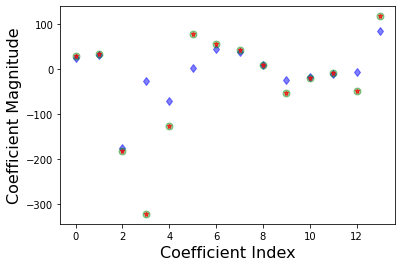

In [ ]:
for x in range(len(model.coef_)):
  plt.plot(ridge.coef_[x],alpha=0.7,linestyle='none',marker='*',markersize=5,color='red',label=r'Ridge; $\alpha = 0.01$',zorder=7) 
  plt.plot(ridge100.coef_[x],alpha=0.5,linestyle='none',marker='d',markersize=6,color='blue',label=r'Ridge; $\alpha = 100$') 
  plt.plot(model.coef_[x],alpha=0.4,linestyle='none',marker='o',markersize=7,color='green',label='Linear Regression')
plt.xlabel('Coefficient Index',fontsize=16)
plt.ylabel('Coefficient Magnitude',fontsize=16)
plt.show()


We wanted see how our coefficients would react with alpha values 0.01 and 100. The blue diamonds are alpha=100 coefficients and the "*"s are alpha=0.01 coefficients. The green dots are non regularized coefficients. We can see that third coefficient,which is room_type, is the one that is most effected by the Ridge Regularization. 

In [ ]:
print("Ridge train score with alpha=0.01: ",ridge_train_score)
print("Ridge test score with alpha=0.01: ",ridge_test_score)

Ridge train score with alpha=0.01:  0.30928581917904885
Ridge test score with alpha=0.01:  0.3147360170924034


We obtained R2 = 0.30928581917904885 for training datas in our alpha=0.01 regularized model.

We obtained R2 = 0.3147360170924034 for test datas in our alpha=0.01 regularized model.

In [ ]:
print("Ridge train score with alpha=100: ",ridge100_train_score)
print("Ridge test score with alpha=100: ",ridge100_test_score)

Ridge train score with alpha=100:  0.3052106188795476
Ridge test score with alpha=100:  0.30944728720409465


We obtained R2 = 0.3052106188795477 for training datas in our alpha=100 regularized model.

We obtained R2 = 0.30944728720409465 for test datas in our alpha=100 regularized model.

In [ ]:
ridge1 = Ridge(alpha=1.0)
ridge1.fit(x_train, y_train)

ridge1_train_score= ridge1.score(x_train, y_train)
ridge1_test_score= ridge1.score(x_test, y_test)

ridge01 = Ridge(alpha= 0.1)
ridge01.fit(x_train, y_train)

ridge01_train_score= ridge1.score(x_train, y_train)
ridge01_test_score= ridge1.score(x_test, y_test)

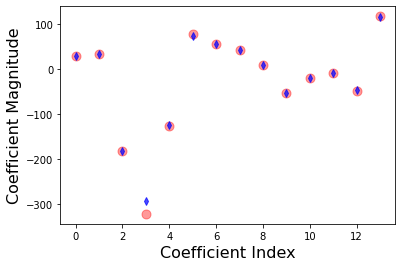

In [ ]:
for x in range(len(model.coef_)):
  plt.plot(ridge1.coef_[x],alpha=0.7,linestyle='none',marker='d',markersize=5,color='blue',label=r'Ridge; $\alpha = 1$',zorder=7) 
  plt.plot(model.coef_[x],alpha=0.4,linestyle='none',marker='o',markersize=9,color='red',label='Linear Regression')
plt.xlabel('Coefficient Index',fontsize=16)
plt.ylabel('Coefficient Magnitude',fontsize=16)
plt.show()

The above graph shows how the model coefficients affected by the Ridge regularization with alpha = 1.

In [ ]:
print("Ridge train score with alpha=1: ",ridge1_train_score)
print("Ridge test score with alpha=1: ",ridge1_test_score)

Ridge train score with alpha=1:  0.30926522682861257
Ridge test score with alpha=1:  0.31456627734255893


We obtained R2 = 0.3092652268286125 for training datas in our alpha=1 regularized model.

We obtained R2 = 0.314566277342559 for test datas in our alpha=1 regularized model.

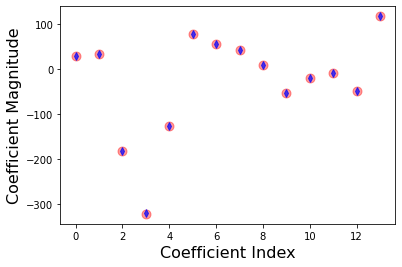

In [ ]:
for x in range(len(model.coef_)):
  plt.plot(ridge01.coef_[x],alpha=0.7,linestyle='none',marker='d',markersize=5,color='blue',label=r'Ridge; $\alpha = 0.1$',zorder=7) 
  plt.plot(model.coef_[x],alpha=0.4,linestyle='none',marker='o',markersize=9,color='red',label='Linear Regression')
plt.xlabel('Coefficient Index',fontsize=16)
plt.ylabel('Coefficient Magnitude',fontsize=16)
plt.show()

The above graph shows how the model coefficients affected by the Ridge regularization with alpha = 0.1 .

In [ ]:
print("Ridge train score with alpha=0.1: ",ridge01_train_score)
print("Ridge test score with alpha=0.1: ",ridge01_test_score)

Ridge train score with alpha=0.1:  0.30926522682861257
Ridge test score with alpha=0.1:  0.31456627734255893


We obtained R2 = 0.3092652268286125 for training datas in our alpha=0.1 regularized model.

We obtained R2 = 0.314566277342559 for test datas in our alpha=0.1 regularized model.

In [ ]:
ridge10 = Ridge(alpha = 10)
ridge10.fit(x_train, y_train)
ridge10_train_score = ridge10.score(x_train, y_train)
ridge10_test_score = ridge10.score(x_train, y_train)

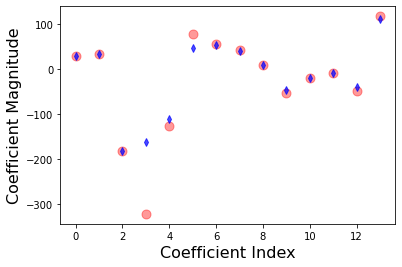

In [ ]:
for x in range(len(model.coef_)):
  plt.plot(ridge10.coef_[x],alpha=0.7,linestyle='none',marker='d',markersize=5,color='blue',label=r'Ridge; $\alpha = 10$',zorder=7) 
  plt.plot(model.coef_[x],alpha=0.4,linestyle='none',marker='o',markersize=9,color='red',label='Linear Regression')
plt.xlabel('Coefficient Index',fontsize=16)
plt.ylabel('Coefficient Magnitude',fontsize=16)
plt.show()

We see how our coefficients reacted to Ridge Regularization with alpha=10. The 3rd, 4th and 5th parameters are ones which are most affected by the regularization.

In [ ]:
print("Ridge train score with alpha=10: ",ridge10_train_score)
print("Ridge test score with alpha=10: ",ridge10_test_score)

Ridge train score with alpha=10:  0.30859161935749846
Ridge test score with alpha=10:  0.30859161935749846


We obtained R2 = 0.30859161935749846 for training datas in our alpha=10 regularized model.

We obtained R2 = 0.30859161935749846 for test datas in our alpha=10 regularized model.

In [ ]:
mse_lr = metrics.mean_squared_error(y_test, model.predict(x_test))
mse001 = metrics.mean_squared_error(y_test, ridge.predict(x_test))
mse01 = metrics.mean_squared_error(y_test, ridge01.predict(x_test))
mse1 = metrics.mean_squared_error(y_test, ridge1.predict(x_test))
mse10 = metrics.mean_squared_error(y_test, ridge10.predict(x_test))
mse100 = metrics.mean_squared_error(y_test, ridge100.predict(x_test))

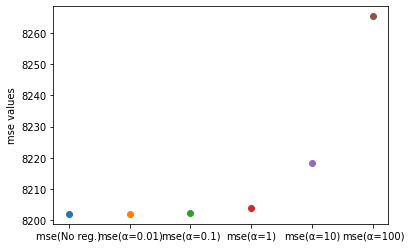

In [ ]:
plt.scatter("mse(No reg.)",mse_lr)
plt.scatter("mse(α=0.01)",mse001)
plt.scatter("mse(α=0.1)",mse01)
plt.scatter("mse(α=1)",mse1)
plt.scatter("mse(α=10)",mse10)
plt.scatter("mse(α=100)",mse100)
plt.ylabel("mse values")
plt.show()

We can see the mse values for non-regularized linear regression model and the ones regularized with different alpha values. What we see is the one with the least mse value is our non regularized Linear Regression model. 

In [ ]:
R_lr = metrics.r2_score(y_test, model.predict(x_test))
r001 = metrics.r2_score(y_test, ridge.predict(x_test))
r01 = metrics.r2_score(y_test, ridge01.predict(x_test))
r1 = metrics.r2_score(y_test, ridge1.predict(x_test))
r10 = metrics.r2_score(y_test, ridge10.predict(x_test))
r100 = metrics.r2_score(y_test, ridge100.predict(x_test))

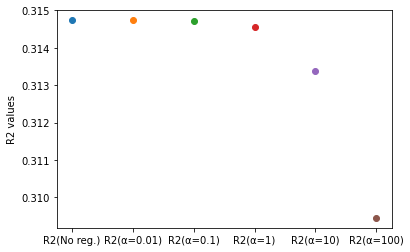

In [ ]:
plt.scatter("R2(No reg.)",R_lr)
plt.scatter("R2(α=0.01)",r001)
plt.scatter("R2(α=0.1)",r01)
plt.scatter("R2(α=1)",r1)
plt.scatter("R2(α=10)",r10)
plt.scatter("R2(α=100)",r100)
plt.ylabel("R2 values")
plt.show()

Again we see that our non-regularized Linear Regression model is the one with most R2 value. 

Conclusion: Our non-regularized Linear Regression model is the best fit model among the Linear Regression models.

In [ ]:
error_list['LinearRegression-Best'] = [mse_lr, r2_lr]
error_list["RegularizedLinearRegression-Best"] = [mse001, r001]
error_list.T

,Mean Squared Error,R2 Score
KNN Default,6932.523404,0.420801
MSE KNN-Best,6744.938181,0.436474
LinearRegression-Best,8202.015289,0.314738
RegularizedLinearRegression-Best,8202.036012,0.314736


### K NEAREST NEIGHBOUR

**K NEAREST NEIGHBOUR** can be used for **regression**. But there is a better model that is **KNeighborsRegressor** which is used for regression tasks. Therefore, we will try ***KNeighborsRegressor*** for our price prediction goal.

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.neighbors import KNeighborsRegressor


knn = KNeighborsRegressor(15, metric="euclidean")
knn.fit(x_train, y_train)
y_pred = knn.predict(x_test)

mse = mean_squared_error(y_pred, y_test)
mae = mean_absolute_error(y_pred, y_test)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error: {}".format(mse))
print("Mean Absolute Error: {}".format(mae))
print("Root Mean Absolute Error: {}".format(rmse))
print("R2 score: {}".format(r2))

Mean Squared Error: 6932.523404109118
Mean Absolute Error: 49.96784855356284
Root Mean Absolute Error: 83.26177636892645
R2 score: 0.42080129951025225


R^2 value, MSE, MAE and RMAE values can be seen above. We have a R2 score: 0.42 and MSE score of 6932.5

In [ ]:
print("prediction: {}".format(y_pred.mean()))
print("Type: {}".format(type(x_test)))

prediction: 139.04232117089262
Type: <class 'numpy.ndarray'>


Mean prediction of our model can be seen above.

In [ ]:
prediction_dictionaries = {'KNN-Default': y_pred}

In [ ]:
prediction_list = pd.DataFrame({'Actual Values': np.array(y_test).flatten(), 'KNN-Default': y_pred.flatten()}).head(20)
prediction_list.set_index('Actual Values', inplace=True)
prediction_list

,KNN-Default
Actual Values,
180,84.266667
130,189.800000
80,108.400000
125,149.066667
85,49.333333
120,164.800000
30,66.066667
165,177.600000
90,85.866667


The actual values of prices and our precictions for the model can be seen above.

In [ ]:
# error_dict = {'KNN Default': [mse, r2]}
error_list = pd.DataFrame()
error_list['KNN Default'] = [mse, r2]
error_list.reset_index(inplace=True, drop=True)
#error_list.rename(columns={0: 'MSE KNN Default'}, inplace=True)
error_list.index =['Mean Squared Error', 'R2 Score']
error_list.T

,Mean Squared Error,R2 Score
KNN Default,6932.523404,0.420801


We create an error list to see the performances of different models as a dataframe. 

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



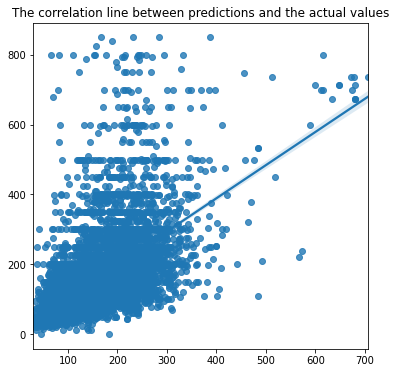

In [ ]:
plt.figure(figsize=(6,6))
sns.regplot(y_pred, y_test)
plt.title("The correlation line between predictions and the actual values")
plt.show()

The regresion line for KNN Default model can be seen above. We can see the correlation between predictions and the actual values.

#### Hyperparameter Tuning and Cross Validation for KNN

Since we have hyperparamaters such as number of nearest neighbour, or distance metric, we will apply hyperparamater tuning to see if we can lower the error. Let's test it by:

Number of Neighbours(1, .... ,10) and
LDistance Function (1: Euclidean, 2: Manhattan)

Cross Validations: 

We will deal with 5 cross validation splits.

We will use GridSearchCV which searchs the model with all possible combinations with using cross validation. It goes over all the models and finds the the model with the best scores 



In [ ]:
# #Bu çok uzun sürüyor, parametre değerleri arttıkça özellikle
from sklearn.model_selection import GridSearchCV
param_grid = {'p': [1, 2],  
              'n_neighbors' : [ 5, 10, 15, 20,35]
              } 
 
grid_knn = GridSearchCV(KNeighborsRegressor(n_jobs=-1), param_grid, refit = True, verbose = 10, n_jobs=-1, cv=5,scoring="neg_mean_squared_error") 
 
grid_knn.fit(features, target)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    7.0s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   13.5s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:   20.7s
[Parallel(n_jobs=-1)]: Done  21 tasks      | elapsed:   32.0s
[Parallel(n_jobs=-1)]: Done  28 tasks      | elapsed:   43.0s
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:  1.4min finished


GridSearchCV(cv=5, error_score=nan,
             estimator=KNeighborsRegressor(algorithm='auto', leaf_size=30,
                                           metric='minkowski',
                                           metric_params=None, n_jobs=-1,
                                           n_neighbors=5, p=2,
                                           weights='uniform'),
             iid='deprecated', n_jobs=-1,
             param_grid={'n_neighbors': [5, 10, 15, 20, 35], 'p': [1, 2]},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring='neg_mean_squared_error', verbose=10)

In [ ]:
print(f"Best parameters are {grid_knn.best_params_}") 
print("Best score is {}".format(grid_knn.best_score_ * -1))
print("Best model is {}".format(grid_knn.best_estimator_))
#print("The score for hyperparameter tuning are {}".format(grid.cv_results_))

Best parameters are {'n_neighbors': 35, 'p': 1}
Best score is 7156.549269931193
Best model is KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=-1, n_neighbors=35, p=1,
                    weights='uniform')


The hyperparameters that are giving best scores are above as 'n_neighbors': 35, 'p': 1

In [ ]:
knr_best = KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=-1, n_neighbors=15, p=1,
                    weights='uniform')
knr_best.fit(x_train, y_train)
y_pred_best = knr_best.predict(x_test)

mse_knn_best = mean_squared_error(y_pred_best, y_test)
mae_knn_best = mean_absolute_error(y_pred, y_test)
rmse_knn_best = np.sqrt(mse)
r2_knn_best = r2_score(y_test, y_pred_best)

print("Mean Squared Error: {}".format(mse_knn_best))
print("Mean Absolute Error: {}".format(mae_knn_best))
print("Root Mean Absolute Error: {}".format(rmse_knn_best))
print("R2 score: {}".format(r2_knn_best))

Mean Squared Error: 6744.938180901991
Mean Absolute Error: 49.96784855356284
Root Mean Absolute Error: 83.26177636892645
R2 score: 0.4364736761008957


We can see the performance measures we obtain with the modified model at hand as:

Mean Squared Error: 6744.938180901991
Mean Absolute Error: 49.96784855356284
Root Mean Absolute Error: 83.26177636892645
R2 score: 0.4364736761008957

In [ ]:
prediction_dictionaries['Knn-Best']  = y_pred_best

In [ ]:
prediction_list['KNN-Best'] = y_pred_best[:20]
prediction_list

,KNN-Default,KNN-Best
Actual Values,,
180,84.266667,82.333333
130,189.800000,236.733333
80,108.400000,116.733333
125,149.066667,142.400000
85,49.333333,51.800000
120,164.800000,169.933333
30,66.066667,70.866667
165,177.600000,179.733333
90,85.866667,91.133333


We add the predictions vs actual values again in the dataframe

In [ ]:
error_list['MSE KNN-Best'] = [mse_knn_best, r2_knn_best]
error_list.T

,Mean Squared Error,R2 Score
KNN Default,6932.523404,0.420801
MSE KNN-Best,6744.938181,0.436474


We also add the new scores in the error list as well.

In [ ]:
def plot_all_r2():
  length = len(prediction_dictionaries)
  n_col = 2
  if length < 2:
    n_col = length % 2
  
  nrow = 1
  if(length > 2):
    nrow = int(length / 2) 
    if length % 2 != 0:
      nrow+=1
  
  fig, axes = plt.subplots(nrow, n_col, figsize=( 16, 3 * length))
  for ax, key in zip(axes.flatten(), prediction_dictionaries.keys()):
    sns.regplot(prediction_dictionaries[key], y_test, ax=ax)
    ax.set_title("The correlation line in {}".format(key))
  plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



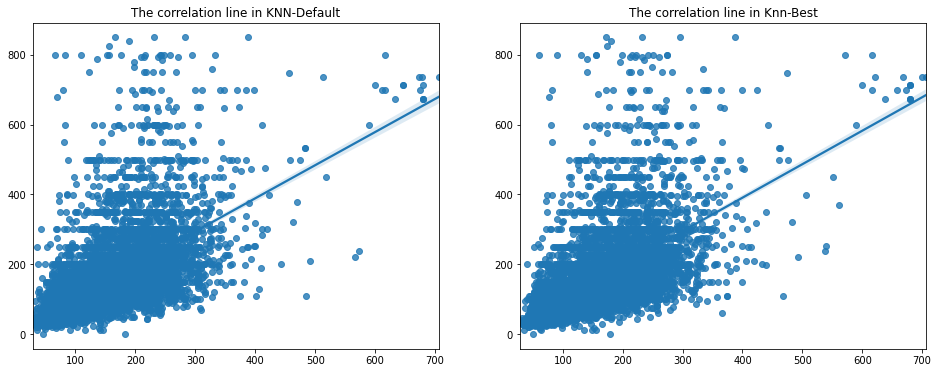

In [ ]:
plot_all_r2()

We can see the regression plots that we obtained prom prediction dictionaries as above.

### Decision Tree Model

In [ ]:
df_ml_kaggle3 = df_ml_kaggle1.copy()
df_ml_targets = df_ml_kaggle1["Price"]
df_ml_features = df_ml_kaggle1.drop(["Price"],axis=1)

####Normalization
Normalization of the data is a very important step prior to applying machine learning models. Normalization reduces the effect of outliers to the machine learning model.

In [ ]:
df_normalized_ml3 = (df_ml_features - df_ml_features.min()) / (df_ml_features.max() - df_ml_features.min())
df_normalized_ml3.head()

,neighbourhood_group,neighbourhood,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,0.25,0.490909,0.5,0.000000,0.014308,0.003419,0.015337,1.000000,0.228814,0.021125,0.294737,0.194558,0.084826,0.112273
1,0.50,0.577273,0.0,0.000000,0.071542,0.006326,0.003067,0.972603,0.125000,0.004205,0.221053,0.063879,0.469041,0.753835
2,0.50,0.427273,0.5,0.001601,0.000000,0.023307,0.000000,1.000000,0.355932,0.026657,0.168421,0.077076,0.499887,0.750814
3,0.25,0.186364,0.0,0.000000,0.429253,0.079159,0.000000,0.531507,0.146186,0.018941,0.284211,0.222085,0.281697,0.276151
4,0.50,0.277273,0.0,0.007206,0.014308,0.001539,0.000000,0.000000,0.951271,0.017638,0.168421,0.069463,0.531186,0.721757


#### Standardization
Standardization (or z-score normalization) scales the values while taking into account standard deviation. If the standard deviation of features is different, their range also would differ from each other. This reduces the effect of the outliers in the features.

In [ ]:
df_std_ml3 = (df_ml_features - df_ml_features.mean()) / df_ml_features.std()
df_std_ml3.head()

,neighbourhood_group,neighbourhood,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,-0.914538,0.014899,0.904880,-0.294675,-0.322254,-0.775943,-0.035426,1.925544,-0.907146,-0.176622,-0.167853,-0.444930,-1.313131,-1.269609
1,0.442124,0.291339,-0.928119,-0.294675,0.483536,-0.662735,-0.156395,1.849379,-1.257661,-0.497086,-0.556544,-1.305819,1.073205,1.994349
2,0.442124,-0.188794,0.904880,-0.196110,-0.523701,-0.001314,-0.186637,1.925544,-0.477943,-0.071833,-0.834180,-1.218876,1.264788,1.978976
3,-0.914538,-0.959916,-0.928119,-0.294675,5.519720,2.174145,-0.186637,0.623117,-1.186128,-0.217987,-0.223380,-0.263592,-0.090380,-0.435881
4,0.442124,-0.668926,-0.928119,0.148864,-0.322254,-0.849196,-0.186637,-0.854489,1.532158,-0.242656,-0.834180,-1.269030,1.459188,1.831151


In [ ]:
#Decision Tree Model
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

In [ ]:
# features
x = df_ml_features
# target attribute
y = df_ml_targets

#### Splitting Training Data and Validation/Testing
We are dividing our data as %80 training data, %10 test data and %10 validation data

In [ ]:
# 80% training, 20% for validation and testing
x_train, x_remaining, y_train, y_remaining = train_test_split(x, y, random_state=0, test_size=0.20)
# divide the remaining part into two
# at the end, you get 10% validation, 10% test
x_val, x_test, y_val, y_test = train_test_split(x_remaining, y_remaining, random_state=0, test_size=0.50)

While creating our decision tree model, we are using DecisionTreeRegressor library since our target data is continuous

In [ ]:
# cross validation function
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeRegressor
# create a model
#model = DecisionTreeClassifier(criterion="entropy", max_depth=5)
#model.fit(x_train, y_train.astype('int'))
model = DecisionTreeRegressor(max_depth=5).fit(x_train, y_train)
# perform CV with the given settings
#accuracies = cross_val_score(model, x_train, y_train.astype('int'), cv=5, scoring="accuracy")
#accuracies

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
train_preds = model.predict(x_train)
val_preds = model.predict(x_val)
y_pred = model.predict(x_test)
#print(accuracy_score(y_train.astype('int'), train_preds))
#print(accuracy_score(y_val.astype('int'), val_preds))
r2_decision_tree = r2_score(y_test, y_pred)
print("R2 score: {}".format(r2_decision_tree))
mse_decision_tree = mean_squared_error(y_test,y_pred)
print("MSE score: {}".format(mse_decision_tree))

R2 score: 0.39088235552916617
MSE score: 6709.375510265622


#### Visualization of the Decision Tree

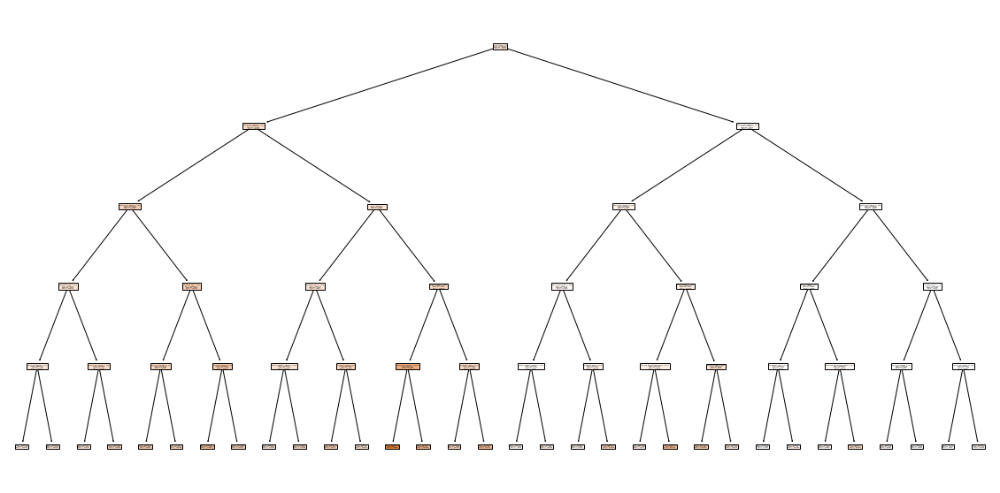

In [ ]:
# tree plot function
from sklearn.tree import plot_tree

# generate the tree
fig = plt.figure(figsize=(20, 10))
plot_tree(model, feature_names=x.columns.values, filled=True);

Addition of the Decision Tree results to our error_list which we use to compare our models

In [ ]:
error_list["Decision Tree-Default"] = [mse_decision_tree,r2_decision_tree]
error_list.T

,Mean Squared Error,R2 Score
KNN Default,6932.523404,0.420801
MSE KNN-Best,6744.938181,0.436474
LinearRegression-Best,8202.015289,0.314738
RegularizedLinearRegression-Best,8202.036012,0.314736
Decision Tree-Default,6709.375510,0.390882


In [ ]:
prediction_dictionaries['Decision Tree-Default']   = y_pred

In [ ]:
prediction_list['Decision Tree-Default'] = y_pred_best[:20]
prediction_list

,KNN-Default,KNN-Best,Linear Regression-Default,Decision Tree-Default
Actual Values,,,,
180,84.266667,82.333333,84.266667,82.333333
130,189.800000,236.733333,189.800000,236.733333
80,108.400000,116.733333,108.400000,116.733333
125,149.066667,142.400000,149.066667,142.400000
85,49.333333,51.800000,49.333333,51.800000
120,164.800000,169.933333,164.800000,169.933333
30,66.066667,70.866667,66.066667,70.866667
165,177.600000,179.733333,177.600000,179.733333
90,85.866667,91.133333,85.866667,91.133333


#### Hyperparameter Tuning for Decision Tree Model
In Decision Tree models, max_depth of the decision tree is the hyperparameter. We are testing a range of max_depths values and take the best result as the best model.

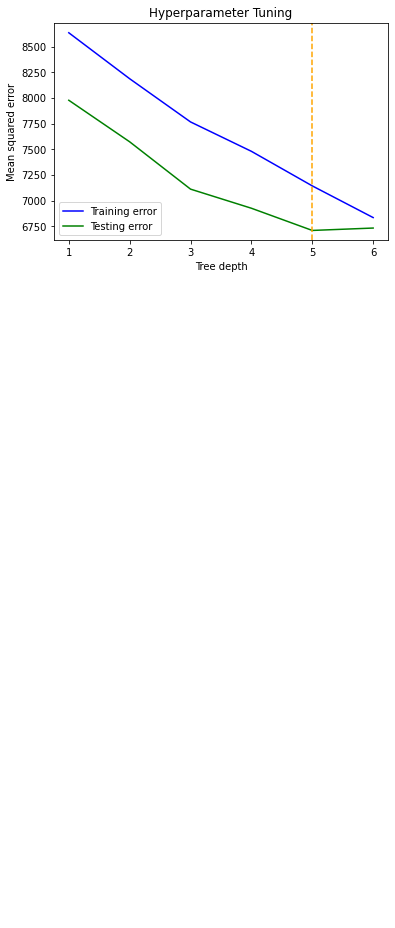

In [ ]:
from sklearn.metrics import mean_squared_error as mse
import matplotlib.pyplot as plt

max_depths = range(1, 7)
training_error = []
for max_depth in max_depths:
    model_1 = DecisionTreeRegressor(max_depth=max_depth)
    model_1.fit(x, y)
    training_error.append(mse(y, model_1.predict(x)))
    
testing_error = []
for max_depth in max_depths:
    model_2 = DecisionTreeRegressor(max_depth=max_depth)
    model_2.fit(x_train, y_train)
    testing_error.append(mse(y_test, model_2.predict(x_test)))


plt.plot(max_depths, training_error, color='blue', label='Training error')
plt.plot(max_depths, testing_error, color='green', label='Testing error')
plt.xlabel('Tree depth')
plt.axvline(x=5, color='orange', linestyle='--')
plt.annotate('optimum = 5', xy=(5, 0.0092), color='red')
plt.ylabel('Mean squared error')
plt.title('Hyperparameter Tuning')
plt.legend()
plt.show()
#plt.savefig('error.png')

#### Best Model's Score 
As the Decision Tree Model is adjusted with the optimal values that we have found in the hyperparameter tuning part, the score of the model is increased by nearly %2

In [ ]:
# Import necessary modules
from scipy.stats import randint
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

# Setup the parameters and distributions to sample from: param_dist
gs = GridSearchCV(model,
                  param_grid = {'max_depth': range(1, 11),
                                'min_samples_split': range(10, 60, 10)},
                  cv=5,
                  n_jobs=1,
                  scoring='neg_mean_squared_error')

gs.fit(x_train, y_train)
# Print the tuned parameters and score
print("Tuned Decision Tree Parameters: {}".format(gs.best_params_))
print("Best score is {}".format(-gs.best_score_))
best_model = gs.best_estimator_
best_model.score(x_test, y_test)

Tuned Decision Tree Parameters: {'max_depth': 8, 'min_samples_split': 40}
Best score is 7023.994585901988


0.4082562292352348

In [ ]:
error_list["Decision Tree-Best"] =[-gs.best_score_,best_model.score(x_test, y_test)]
error_list.T

,Mean Squared Error,R2 Score
KNN Default,6932.523404,0.420801
MSE KNN-Best,6744.938181,0.436474
LinearRegression-Best,8202.015289,0.314738
RegularizedLinearRegression-Best,8202.036012,0.314736
Decision Tree-Default,6709.375510,0.390882
Decision Tree-Best,7023.994586,0.408256


In [ ]:
prediction_dictionaries['Decision Tree-Best']   = y_pred_best

In [ ]:
prediction_list['Decision Tree-Best'] = y_pred[:20]
prediction_list

,KNN-Default,KNN-Best,Linear Regression-Default,Decision Tree-Default,Decision Tree-Best
Actual Values,,,,,
180,84.266667,82.333333,84.266667,82.333333,72.678810
130,189.800000,236.733333,189.800000,236.733333,53.529957
80,108.400000,116.733333,108.400000,116.733333,65.482506
125,149.066667,142.400000,149.066667,142.400000,179.065779
85,49.333333,51.800000,49.333333,51.800000,83.821685
120,164.800000,169.933333,164.800000,169.933333,72.678810
30,66.066667,70.866667,66.066667,70.866667,72.678810
165,177.600000,179.733333,177.600000,179.733333,65.482506
90,85.866667,91.133333,85.866667,91.133333,65.482506


###Comparison of the Models

In [ ]:
print("MSE of kNN model: ",mse_knn_best,"R2 of kNN model: ",r2_knn_best)
print("MSE of Decision Tree: ",mse_decision_tree,"R2 of Decision Tree",r2_decision_tree)
print("MSE of Linear Regression",mse_lr,"R2 of Linear Regression", r2_lr)

MSE of kNN model:  6744.938180901991 R2 of kNN model:  0.4364736761008957
MSE of Decision Tree:  6709.375510265622 R2 of Decision Tree 0.39088235552916617
MSE of Linear Regression 8202.015289151426 R2 of Linear Regression 0.31473774844269187


In [ ]:
error_list = error_list.T

In [ ]:
error_list

,Mean Squared Error,R2 Score
KNN Default,6932.523404,0.420801
MSE KNN-Best,6744.938181,0.436474
LinearRegression-Best,8202.015289,0.314738
RegularizedLinearRegression-Best,8202.036012,0.314736
Decision Tree-Default,6709.375510,0.390882
Decision Tree-Best,7023.994586,0.408256


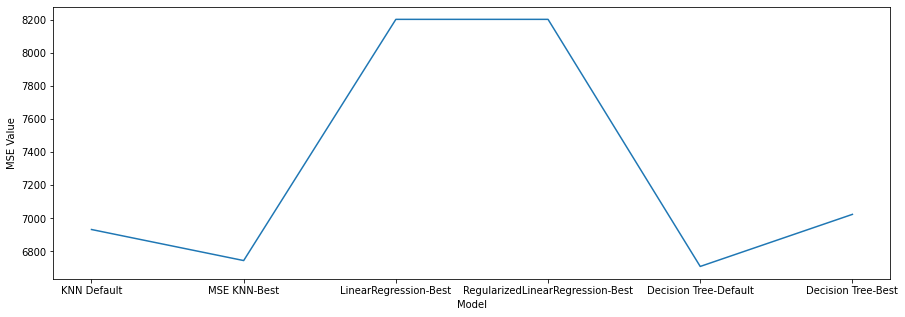

In [ ]:
plt.plot(error_list.index,error_list["Mean Squared Error"])
plt.xlabel("Model")
plt.ylabel("MSE Value")
plt.show()

When we look at the mean squared errors of all machine learning models we fitted, we see that linear_regression_best and regularized_linear_regression_best are the worst ones.

 And the best ones are MSE KNN_Best and Decision Tree_Default. 

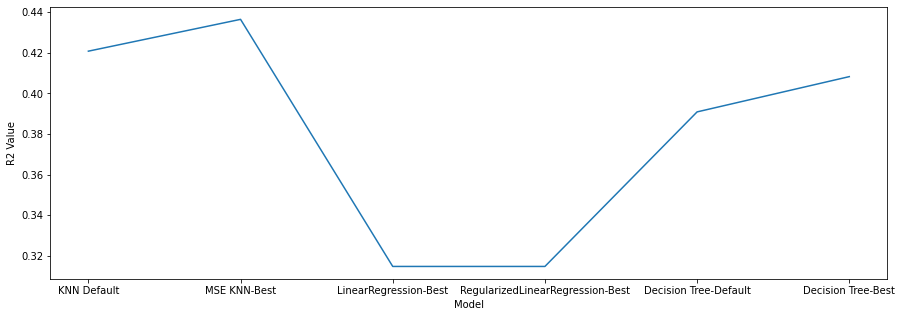

In [ ]:
plt.plot(error_list.index,error_list["R2 Score"])
plt.xlabel("Model")
plt.ylabel("R2 Value")
plt.show()

When we have a look, at the R^2 values in the above graph, we see that KNN-Best is the best one in terms of explaining the variation of the data as R^2. The worst ones are LinearRegression-Best and RegularizedLinearRegression-Best with lowest R^2 values.

**Conclusion:**
According to the results we obtained above, we can conclude that KNN-Best is the Best model we have fitted both in terms of mse and R^2 values. We can say that the best prediction can be done by KNN-Best.

## Introduction


In this project, we are aiming to predict prices of Airbnb houses. In order to do this predictions we are utilizing a real-world dataset from Airbnb that includes detailed information on the hosts in New York City as of 2019. The dataset contains registered Airbnb hosts and their associated attributes, such as location, price, number of reviews and availability. Additionaly, we are using 3 more datasets to get more insight about the topic 

We are asking questions to get insights from data and answer them quantitatively. We are discovering the structure in the data and applying what we have learned so far in the visualiziations of the data.

`Installing required libraries`

In [ ]:
from google.colab import drive
drive.mount("./drive", force_remount=True)
import pandas as pd  # an alias for pandas
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px #for heatmap
import seaborn as sns
import scipy.stats as stats
from statsmodels.formula.api import ols
import statsmodels.api as sm


!pip install bioinfokit
from bioinfokit.analys import stat


from numpy import cos, sin, arcsin, sqrt
from math import radians

from os.path import join

# displaying option
pd.set_option('max_rows', 50)
%matplotlib inline

path_prefix = "./drive/My Drive"

Mounted at ./drive


/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



     |████████████████████████████████| 92kB 5.8MB/s 
  Created wheel for bioinfokit: filename=bioinfokit-2.0.4-cp37-none-any.whl size=56008 sha256=08d31c37285f122251db0187c2fce564ff3c93c5ada13e36369b490d5a65c521
  Stored in directory: /root/.cache/pip/wheels/43/cf/aa/4a4fe54a3edb663ee7bd9b245bd946506c8bd4b99f4ae00507
  Created wheel for adjustText: filename=adjustText-0.7.3-cp37-none-any.whl size=7100 sha256=07ef98e6ac87e2581e1ae4f3c0ec55a852cb5d58ffa0a8e3d7ca583f89c177f9
  Stored in directory: /root/.cache/pip/wheels/41/95/74/7d347e136d672f8bc28e937032bc92baf4f80856763a7e7b72
Successfully built bioinfokit adjustText


`Reading the .csv files of our datasets using pandas`

In [ ]:
fname = "POI.csv"
fname2 = "kaggle.csv"
fname3 = "subway.csv"
fname4 = "complaint.csv"
# we use the read_csv function
# to read the dataset into a dataframe
# it returns the dataframe object
df_poi = pd.read_csv(join(path_prefix, fname))
df_kaggle = pd.read_csv(join(path_prefix, fname2))
df_subway = pd.read_csv(join(path_prefix, fname3))
df_complaints = pd.read_csv(join(path_prefix, fname4))
#index = df_c_kaggle.index
#number_of_rows_kaggle = len(index)
#index = df_subway.index
#number_of_rows_subway = len(index)

#### General Usage Functions

[link text](https://)In some datasets coordinates are given as string and in a non-readable format. longConverter and latConverter functions are used to extract coordinates from these datasets.

In [ ]:
def longConverter(x):
    x = x.split()[1:]
    return np.float(x[0].lstrip("("))

def latConverter(x):
  x = x.split()[1:]
  return np.float(x[1].rstrip(")"))

Haversine function is used to calculate the distance between two given coordinates. This function is used to add new features to our main dataset. Finding the nearest subway, POI and complaint for each house listed in Airbnb.

In [ ]:
def haversine(row, lon1, lat1): # send me home and location of a subway, i will find you the distance between them.
    lon2 = row['longitude']
    lat2 = row['latitude']
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * arcsin(sqrt(a)) 
    km = 6367 * c
    return km

### Utilized Datasets

#### Main Dataset (Kaggle)

In [ ]:
df_kaggle.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [ ]:
df_kaggle.shape

(48895, 16)

In [ ]:
df_kaggle.dtypes

id                                  int64
name                               object
host_id                             int64
host_name                          object
neighbourhood_group                object
neighbourhood                      object
latitude                          float64
longitude                         float64
room_type                          object
price                               int64
minimum_nights                      int64
number_of_reviews                   int64
last_review                        object
reviews_per_month                 float64
calculated_host_listings_count      int64
availability_365                    int64
dtype: object

In [ ]:
df_kaggle.info()  # a summary of the dataframe

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

In [ ]:
df_kaggle.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [ ]:
df_kaggle.count()

id                                48895
name                              48879
host_id                           48895
host_name                         48874
neighbourhood_group               48895
neighbourhood                     48895
latitude                          48895
longitude                         48895
room_type                         48895
price                             48895
minimum_nights                    48895
number_of_reviews                 48895
last_review                       38843
reviews_per_month                 38843
calculated_host_listings_count    48895
availability_365                  48895
dtype: int64

In [ ]:
df_kaggle.nunique()

id                                48895
name                              47905
host_id                           37457
host_name                         11452
neighbourhood_group                   5
neighbourhood                       221
latitude                          19048
longitude                         14718
room_type                             3
price                               674
minimum_nights                      109
number_of_reviews                   394
last_review                        1764
reviews_per_month                   937
calculated_host_listings_count       47
availability_365                    366
dtype: int64

In [ ]:
df_kaggle.isna().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

#### Additional Dataset (Subway)

In [ ]:
df_subway.head()

,URL,OBJECTID,NAME,the_geom,LINE,NOTES
0,http://web.mta.info/nyct/service/,1,Astor Pl,POINT (-73.99106999861966 40.73005400028978),4-6-6 Express,"4 nights, 6-all times, 6 Express-weekdays AM s..."
1,http://web.mta.info/nyct/service/,2,Canal St,POINT (-74.00019299927328 40.71880300107709),4-6-6 Express,"4 nights, 6-all times, 6 Express-weekdays AM s..."
2,http://web.mta.info/nyct/service/,3,50th St,POINT (-73.98384899986625 40.76172799961419),1-2,"1-all times, 2-nights"
3,http://web.mta.info/nyct/service/,4,Bergen St,POINT (-73.97499915116808 40.68086213682956),2-3-4,"4-nights, 3-all other times, 2-all times"
4,http://web.mta.info/nyct/service/,5,Pennsylvania Ave,POINT (-73.89488591154061 40.66471445143568),3-4,"4-nights, 3-all other times"


In [ ]:
df_subway.shape

(473, 6)

In [ ]:
df_subway.dtypes

URL         object
OBJECTID     int64
NAME        object
the_geom    object
LINE        object
NOTES       object
dtype: object

In [ ]:
df_subway.info()  # a summary of the dataframe

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 473 entries, 0 to 472
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   URL       473 non-null    object
 1   OBJECTID  473 non-null    int64 
 2   NAME      473 non-null    object
 3   the_geom  473 non-null    object
 4   LINE      473 non-null    object
 5   NOTES     473 non-null    object
dtypes: int64(1), object(5)
memory usage: 22.3+ KB


In [ ]:
df_subway.describe()

,OBJECTID
count,473.000000
mean,238.078224
std,139.190015
min,1.000000
25%,119.000000
50%,237.000000
75%,355.000000
max,643.000000


In [ ]:
df_subway.nunique()

URL           1
OBJECTID    473
NAME        355
the_geom    473
LINE         66
NOTES       105
dtype: int64

In [ ]:
df_subway.isna().sum()

URL         0
OBJECTID    0
NAME        0
the_geom    0
LINE        0
NOTES       0
dtype: int64

####Additional Dataset (POI)

In [ ]:
df_poi.head()

,the_geom,OBJECTID,Id,Name,Stacked,AnnoLine1,AnnoLine3,Borough,AnnoLine4,AnnoLine2a,Angle
0,POINT (-73.88895811640342 40.8962098695574),1,90,Van Cortlandt Park,3,Van,Park,Bronx,NaN,Cortlandt,0
1,POINT (-73.87165102682086 40.88987947152594),2,95,Woodlawn Cemetery,2,Woodlawn,NaN,Bronx,NaN,Cemetery,0
2,POINT (-73.8386418872537 40.88696522165708),3,81,Seton Falls Park,3,Seton,Park,Bronx,NaN,Falls,0
3,POINT (-73.80980242290379 40.87798554992497),4,69,Pelham Bay Park,3,Pelham,Park,Bronx,NaN,Bay,0
4,POINT (-73.87830775950145 40.864423947038276),5,8,Botanical Garden,2,Botanical,NaN,Bronx,NaN,Garden,0


In [ ]:
df_poi.shape

(96, 11)

In [ ]:
df_poi.dtypes

the_geom      object
OBJECTID       int64
Id             int64
Name          object
Stacked        int64
AnnoLine1     object
AnnoLine3     object
Borough       object
AnnoLine4     object
AnnoLine2a    object
Angle          int64
dtype: object

In [ ]:
df_poi.info()  # a summary of the dataframe

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96 entries, 0 to 95
Data columns (total 11 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   the_geom    96 non-null     object
 1   OBJECTID    96 non-null     int64 
 2   Id          96 non-null     int64 
 3   Name        96 non-null     object
 4   Stacked     96 non-null     int64 
 5   AnnoLine1   96 non-null     object
 6   AnnoLine3   32 non-null     object
 7   Borough     96 non-null     object
 8   AnnoLine4   2 non-null      object
 9   AnnoLine2a  92 non-null     object
 10  Angle       96 non-null     int64 
dtypes: int64(4), object(7)
memory usage: 8.4+ KB


In [ ]:
df_poi.describe()

,OBJECTID,Id,Stacked,Angle
count,96.000000,96.000000,96.000000,96.000000
mean,49.187500,48.500000,2.260417,1.208333
std,29.088725,27.856777,0.684333,8.685035
min,1.000000,1.000000,0.000000,0.000000
25%,24.750000,24.750000,2.000000,0.000000
50%,48.500000,48.500000,2.000000,0.000000
75%,72.250000,72.250000,3.000000,0.000000
max,109.000000,96.000000,4.000000,75.000000


In [ ]:
df_poi.nunique()

the_geom      96
OBJECTID      96
Id            96
Name          96
Stacked        5
AnnoLine1     88
AnnoLine3      6
Borough        5
AnnoLine4      2
AnnoLine2a    44
Angle          3
dtype: int64

In [ ]:
df_poi.isna().sum()

the_geom       0
OBJECTID       0
Id             0
Name           0
Stacked        0
AnnoLine1      0
AnnoLine3     64
Borough        0
AnnoLine4     94
AnnoLine2a     4
Angle          0
dtype: int64

#### Additional Dataset (Complaints)

In [ ]:
df_complaints.head()

,CMPLNT_NUM,ADDR_PCT_CD,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,HADEVELOPT,HOUSING_PSA,JURISDICTION_CODE,JURIS_DESC,KY_CD,LAW_CAT_CD,LOC_OF_OCCUR_DESC,OFNS_DESC,PARKS_NM,PATROL_BORO,PD_CD,PD_DESC,PREM_TYP_DESC,RPT_DT,STATION_NAME,SUSP_AGE_GROUP,SUSP_RACE,SUSP_SEX,TRANSIT_DISTRICT,VIC_AGE_GROUP,VIC_RACE,VIC_SEX,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lat_Lon,New Georeferenced Column
0,885776788,66,NaN,12/23/2020,19:50:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,OUTSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,12/23/2020,NaN,NaN,NaN,NaN,NaN,18-24,BLACK,M,986633,167258,40.625769,-73.991417,"(40.62576896100006, -73.99141682199996)",POINT (-73.99141682199996 40.62576896100006)
1,350637195,77,NaN,12/21/2020,01:10:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,INSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,12/21/2020,NaN,NaN,NaN,NaN,NaN,25-44,BLACK,M,1003606,185050,40.674583,-73.930222,"(40.67458330800008, -73.93022154099998)",POINT (-73.93022154099998 40.67458330800008)
2,347843168,43,BRONX,11/22/2020,22:00:00,NaN,NaN,COMPLETED,NaN,NaN,0.0,N.Y. POLICE DEPT,104,FELONY,NaN,RAPE,NaN,PATROL BORO BRONX,157.0,RAPE 1,STREET,11/23/2020,NaN,UNKNOWN,UNKNOWN,U,NaN,25-44,BLACK,F,1020316,239179,40.823101,-73.869690,"(40.82310129900002, -73.86969046099993)",POINT (-73.86969046099993 40.82310129900002)
3,197941396,47,NaN,11/22/2020,09:50:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,INSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,11/22/2020,NaN,25-44,BLACK,M,NaN,25-44,BLACK,F,1026387,262634,40.887451,-73.847608,"(40.88745131300004, -73.84760778699997)",POINT (-73.84760778699997 40.88745131300004)
4,298404927,25,NaN,11/21/2020,15:38:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. HOUSING POLICE,101,FELONY,OUTSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,11/21/2020,NaN,NaN,NaN,NaN,NaN,18-24,BLACK HISPANIC,M,1003396,230824,40.800222,-73.930848,"(40.80022202900005, -73.93084834199995)",POINT (-73.93084834199995 40.80022202900005)


In [ ]:
df_complaints.shape

(413412, 36)

In [ ]:
df_complaints.dtypes

CMPLNT_NUM                    int64
ADDR_PCT_CD                   int64
BORO_NM                      object
CMPLNT_FR_DT                 object
CMPLNT_FR_TM                 object
CMPLNT_TO_DT                 object
CMPLNT_TO_TM                 object
CRM_ATPT_CPTD_CD             object
HADEVELOPT                   object
HOUSING_PSA                 float64
JURISDICTION_CODE           float64
JURIS_DESC                   object
KY_CD                         int64
LAW_CAT_CD                   object
LOC_OF_OCCUR_DESC            object
OFNS_DESC                    object
PARKS_NM                     object
PATROL_BORO                  object
PD_CD                       float64
PD_DESC                      object
PREM_TYP_DESC                object
RPT_DT                       object
STATION_NAME                 object
SUSP_AGE_GROUP               object
SUSP_RACE                    object
SUSP_SEX                     object
TRANSIT_DISTRICT            float64
VIC_AGE_GROUP               

In [ ]:
df_complaints.info()  # a summary of the dataframe

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 413412 entries, 0 to 413411
Data columns (total 36 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   CMPLNT_NUM                413412 non-null  int64  
 1   ADDR_PCT_CD               413412 non-null  int64  
 2   BORO_NM                   412927 non-null  object 
 3   CMPLNT_FR_DT              413412 non-null  object 
 4   CMPLNT_FR_TM              413412 non-null  object 
 5   CMPLNT_TO_DT              374308 non-null  object 
 6   CMPLNT_TO_TM              374433 non-null  object 
 7   CRM_ATPT_CPTD_CD          413412 non-null  object 
 8   HADEVELOPT                1570 non-null    object 
 9   HOUSING_PSA               30967 non-null   float64
 10  JURISDICTION_CODE         412949 non-null  float64
 11  JURIS_DESC                413412 non-null  object 
 12  KY_CD                     413412 non-null  int64  
 13  LAW_CAT_CD                413412 non-null  o

In [ ]:
df_complaints.describe()

,CMPLNT_NUM,ADDR_PCT_CD,HOUSING_PSA,JURISDICTION_CODE,KY_CD,PD_CD,TRANSIT_DISTRICT,X_COORD_CD,Y_COORD_CD,Latitude,Longitude
count,4.134120e+05,413412.000000,30967.000000,412949.000000,413412.000000,412949.000000,7233.000000,4.134120e+05,413412.000000,413412.000000,413412.000000
mean,5.493586e+08,63.989976,7194.914070,0.643767,304.496205,390.609458,13.852758,1.005765e+06,207757.373910,40.736879,-73.922337
std,2.597324e+08,34.471968,14347.621144,6.574193,159.525502,210.350418,12.572699,2.126160e+04,30289.581637,0.083142,0.076677
min,1.000014e+08,1.000000,218.000000,0.000000,101.000000,100.000000,1.000000,9.134110e+05,121131.000000,40.498905,-74.254743
25%,3.237774e+08,40.000000,489.000000,0.000000,117.000000,254.000000,2.000000,9.932530e+05,185117.500000,40.674744,-73.967502
50%,5.496216e+08,66.000000,720.000000,0.000000,341.000000,343.000000,11.000000,1.005026e+06,206689.000000,40.733942,-73.925002
75%,7.741082e+08,101.000000,1269.000000,0.000000,351.000000,637.000000,30.000000,1.017356e+06,235517.000000,40.813107,-73.880392
max,9.999989e+08,123.000000,71750.000000,97.000000,678.000000,922.000000,34.000000,1.067185e+06,271820.000000,40.912723,-73.700720


In [ ]:
df_complaints.nunique()

CMPLNT_NUM                  413412
ADDR_PCT_CD                     77
BORO_NM                          5
CMPLNT_FR_DT                  1792
CMPLNT_FR_TM                  1440
CMPLNT_TO_DT                  1264
CMPLNT_TO_TM                  1440
CRM_ATPT_CPTD_CD                 2
HADEVELOPT                      25
HOUSING_PSA                    339
JURISDICTION_CODE               18
JURIS_DESC                      18
KY_CD                           64
LAW_CAT_CD                       3
LOC_OF_OCCUR_DESC                5
OFNS_DESC                       59
PARKS_NM                       508
PATROL_BORO                      8
PD_CD                          345
PD_DESC                        336
PREM_TYP_DESC                   74
RPT_DT                         366
STATION_NAME                   362
SUSP_AGE_GROUP                  17
SUSP_RACE                        7
SUSP_SEX                         3
TRANSIT_DISTRICT                12
VIC_AGE_GROUP                   26
VIC_RACE            

In [ ]:
df_complaints.isna().sum()

CMPLNT_NUM                       0
ADDR_PCT_CD                      0
BORO_NM                        485
CMPLNT_FR_DT                     0
CMPLNT_FR_TM                     0
CMPLNT_TO_DT                 39104
CMPLNT_TO_TM                 38979
CRM_ATPT_CPTD_CD                 0
HADEVELOPT                  411842
HOUSING_PSA                 382445
JURISDICTION_CODE              463
JURIS_DESC                       0
KY_CD                            0
LAW_CAT_CD                       0
LOC_OF_OCCUR_DESC            66086
OFNS_DESC                        6
PARKS_NM                    410736
PATROL_BORO                    463
PD_CD                          463
PD_DESC                        463
PREM_TYP_DESC                 1172
RPT_DT                           0
STATION_NAME                406179
SUSP_AGE_GROUP               94862
SUSP_RACE                    94862
SUSP_SEX                     94862
TRANSIT_DISTRICT            406179
VIC_AGE_GROUP                    1
VIC_RACE            

## Visualizations Descriptive Statistics

### Main Dataset (Kaggle) Visualizations

In this dataset, data for Airbnb houses are available. It is possible to examine the correlation between many columns such as price vs. number of reviews. We have analyzed the data with visualizations such as scatter plots, bar charts and boxplots. In some columns, we cleaned our data to have better accuracy. We have achieved a great insight about our data while doing this part of project.


#### Bar Charts

`Neighbourhood group(x) vs Number of listings(y)`

neighbourhood_group
Bronx             1091
Brooklyn         20104
Manhattan        21661
Queens            5666
Staten Island      373
Name: host_id, dtype: int64


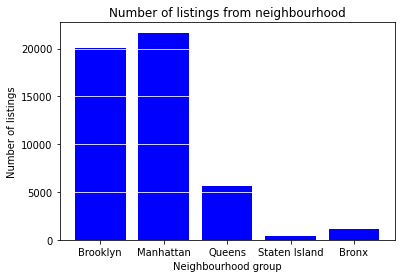

In [ ]:
df_c_kaggle = df_kaggle.copy()
neighbourhoods = df_c_kaggle.loc[:,"neighbourhood_group"].values

neighbourhoods = pd.Series(neighbourhoods)
neighbourhoods = neighbourhoods.unique()

counts = df_c_kaggle.groupby("neighbourhood_group").host_id.count()

print(counts)

yaxis = []

for element in neighbourhoods:
  yaxis.append(counts[element])

plt.bar(neighbourhoods, yaxis, color='blue')
plt.xlabel("Neighbourhood group")
plt.ylabel("Number of listings")
plt.title("Number of listings from neighbourhood")
plt.grid(axis= 'y', c='w');

plt.show()

Here we plotted the total number of listings for each of the Neighbourhood Groups (Brooklyn, Manhattan, Queens, Staten Island, Bronx). We can generealize that Brookly and Manhattan listings are both about 50% of total listings and the small rest is the Queens, Staten Island and Bronx listings.

`Neighbourhood group(x) vs Mean price(y)`

['Brooklyn' 'Manhattan' 'Queens' 'Staten Island' 'Bronx']
neighbourhood_group
Bronx             87.496792
Brooklyn         124.383207
Manhattan        196.875814
Queens            99.517649
Staten Island    114.812332
Name: price, dtype: float64


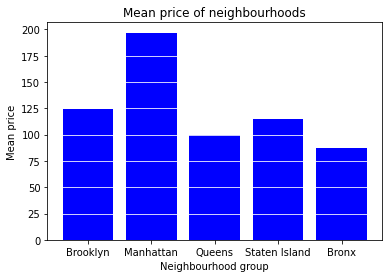

In [ ]:
neighbourhoods = df_c_kaggle.loc[:,"neighbourhood_group"].values

neighbourhoods = pd.Series(neighbourhoods)
neighbourhoods = neighbourhoods.unique()
print(neighbourhoods)

mean_price = df_c_kaggle.groupby("neighbourhood_group").price.mean()

print(mean_price)

yaxis = []

for element in neighbourhoods:
  yaxis.append(mean_price[element])


#mean_price = df_c_kaggle.groupby("neighbourhood_group").price
#mean_price = pd.Series(mean_price)
#mean_price = list(mean_price)
#print(mean_price)
#neighbourhoods = list(set(neighbourhoods))
plt.grid(axis= 'y', c='w');

plt.bar(neighbourhoods, yaxis, color='blue')
plt.xlabel("Neighbourhood group")
plt.ylabel("Mean price")
plt.title("Mean price of neighbourhoods")

plt.show()

We here plotted the Mean Price for each Neighbourhood Group. According to this chart, Manhattan has the highest mean price with 200 and the rest are around 100. We aimed to draw a relation between price and neighbourhood group in this plot.

`Room types(x) vs Number of listings(y)`

['Private room' 'Entire home/apt' 'Shared room']
room_type
Entire home/apt    25409
Private room       22326
Shared room         1160
Name: host_id, dtype: int64


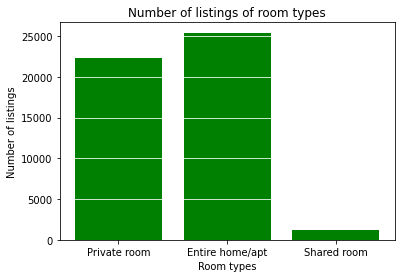

In [ ]:
room_types = df_c_kaggle.loc[:,"room_type"].values
room_types = pd.Series(room_types)
room_types = room_types.unique()
print(room_types)

room_type_counts = df_c_kaggle.groupby("room_type").host_id.count()

print(room_type_counts)

room_types_y = []

for element in room_types:
  room_types_y.append(room_type_counts[element])

# room_type_counts = df_c_kaggle.groupby("room_type").host_id.count()
# room_type_counts = list(room_type_counts)
# print(room_type_counts)

plt.bar(room_types, room_types_y, color='green')
plt.xlabel("Room types")
plt.ylabel("Number of listings")
plt.title("Number of listings of room types")
plt.grid(axis= 'y', c='w');

plt.show()

In this plot we wanted to see the distribution of listings for each of the room types. We wanted to see if there is any relation between number of listings and room types in this plot. Whereas almost half of the listings are Private Room and the almost the other half of the people listed Entire Homes, Shared Rooms has very small amount of listings contrasting to the other two.

#### Histograms

`Prices(x) vs Frequencies(y)`


In this figure, we have the histogram of frequences of prices, we see that prices tend to take place most frequently around 100. We limited the x axis by 600 to see the distribution clearer and open. After 600, it remains constant at a low frequency. Thus, we will mostly deal with prices of 50 to 200.
The yellow line stands for the median and red line stands for mean. We seeclearly that the distribution is skewed to the right which meanse there are many greater values at low frequencies. 

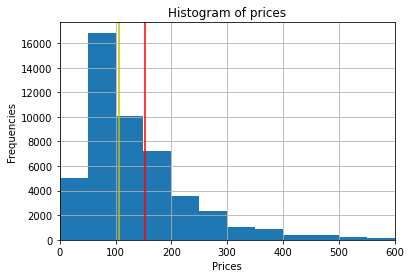

In [ ]:
x = df_c_kaggle["price"]
plt.hist(x, bins=200)
plt.xlim(xmin=0, xmax=600)
plt.xlabel("Prices")
plt.ylabel("Frequencies")
plt.title("Histogram of prices")
plt.axvline(df_c_kaggle['price'].mean(), 0, 1, c="r")
plt.axvline(df_c_kaggle['price'].median(), 0, 1, c="y")

plt.grid();


plt.show()

#### Scatter Plots

`number_of_reviews(x) vs Price(y)`

In this figure, we have the scatter plot of price vs. number of reviews. We see that we have a low negative correlation of 4.7% between the variables. This is probably mainly because we have a dense-random values in the points at lower axises and this makes the correlation low. This is lonely is not enough toexplain the price behaviour but may be up to something when use with othervariables in our machine learning model.



                      price  number_of_reviews
price              1.000000          -0.056082
number_of_reviews -0.056082           1.000000


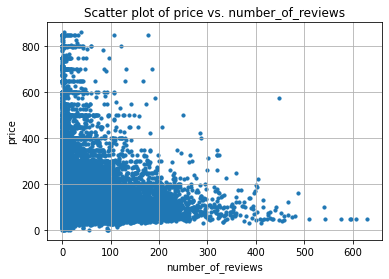

In [ ]:
price = df_c_kaggle.loc[:,"price"].values

#log_price = np.log(price) # Log transformation has been tried

num_of_reviews = df_c_kaggle.loc[:,"number_of_reviews"].values

#log_number_of_reviews = np.log("number_of_reviews) # Log transformation has been tried

plt.scatter(num_of_reviews, price, s=10)
print(df_c_kaggle[["price", "number_of_reviews"]].corr())
plt.grid();
plt.title("Scatter plot of price vs. number_of_reviews")

plt.ylabel("price")
plt.xlabel("number_of_reviews")
plt.show()

`minimum_nigths(x) vs Price(y)`

In this figure, we have the scatter plot of price vs. minimum_night. We see that we have a low positive correlation of 4.7% between the variables. This is probably mainly because we have a dense-random values in the points at lower axises and this makes the correlation low again. This variable is  lonely not enough to explain the price behaviour but may be up to something when use with othervariables in our machine learning model as well.


                   price  minimum_nights
price           1.000000        0.023357
minimum_nights  0.023357        1.000000


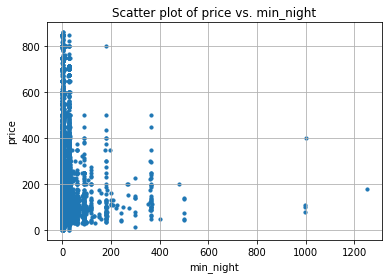

In [ ]:
price = df_c_kaggle.loc[:,"price"].values

#log_price = np.log(price) # Log transformation has been tried

min_nights = df_c_kaggle.loc[:,"minimum_nights"].values

#log_min_nights = np.log(min_nights) # Log transformation has been tried

plt.scatter(min_nights,price, s=10)
plt.grid();
print(df_c_kaggle[["price", "minimum_nights"]].corr())

# df_c_kaggle[["price","minimum_nights"]].corr()
plt.title("Scatter plot of price vs. min_night")

plt.ylabel("price")
plt.xlabel("min_night")
plt.show()

`neighbourhood_group(x) vs price(y)`

In this figure, we have the scatter plot of price vs. neighbourhood_group. We see that Manhattan is the most expensive neighbourhood and Brooklyn is the second most expensive. We see that Staten Island seems to be the least expensive neighbourhood among all.

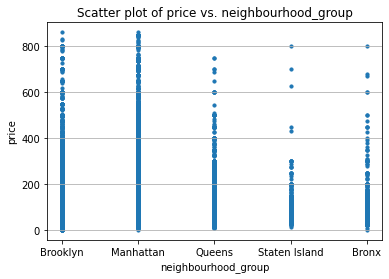

In [ ]:
price = df_c_kaggle.loc[:,"price"].values

#log_price = np.log(price) # Log transformation has been tried

neighbourhood_group = df_c_kaggle.loc[:,"neighbourhood_group"].values

#log_min_nights = np.log(min_nights) # Log transformation has been tried

plt.scatter(neighbourhood_group,price, s=10)
plt.grid(axis= 'y');
# print(df_c_kaggle[["price", "neighbourhood_group"]].corr())

plt.title("Scatter plot of price vs. neighbourhood_group")

plt.ylabel("price")
plt.xlabel("neighbourhood_group")
plt.show()

`Reviews per Month(x) vs Price(y)`

In this figure, we have the scatter plot of price vs. reviews_per_month. We see that we have a low negative correlation of 2.3% between the variables. This is probably mainly because we have a dense-random values in the points at lower axises and this makes the correlation low again as well. This variable is  lonely may not be enough to explain the price behaviour but may be up to something when use with othervariables in our machine learning model as well.

                      price  reviews_per_month
price              1.000000          -0.025218
reviews_per_month -0.025218           1.000000


Text(0, 0.5, 'price')

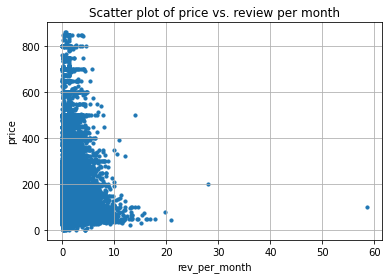

In [ ]:
price = df_c_kaggle.loc[:,"price"].values

sum = np.sum(df_c_kaggle[df_c_kaggle.loc[:, "reviews_per_month"].isna() != True].reviews_per_month.values)
noofitems = df_c_kaggle[df_c_kaggle.loc[:, "reviews_per_month"].isna() != True].host_id.size
mean = sum / noofitems

df_c_kaggle.reviews_per_month.fillna(mean,inplace = True)
rev_per_month = df_c_kaggle.loc[:,"reviews_per_month"].values

plt.title("Scatter plot of price vs. review per month")

plt.scatter(rev_per_month,price,s=10)
plt.grid();

print(df_c_kaggle[["price","reviews_per_month"]].corr())
plt.xlabel("rev_per_month")
plt.ylabel("price")

#plt.show()

`availability-365(x) vs price(y)`

In this figure, we have the scatter plot of price vs. availability 365. We see that we have a low positive correlation of 8.2% between the variables. This is probably mainly because we have a dense-random values in the higher points of x axis and lower points of the y axis and this makes the correlation low again as well. Additionally, we took the log transformation of availability_365 because there were so much dense points at relative areas and there were so much dense difference because of that. This variable is lonely may not be enough to explain the price behaviour but may be up to something when use with othervariables in our machine learning model as well.

                     price  availability_365
price             1.000000          0.113529
availability_365  0.113529          1.000000


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning:

divide by zero encountered in log



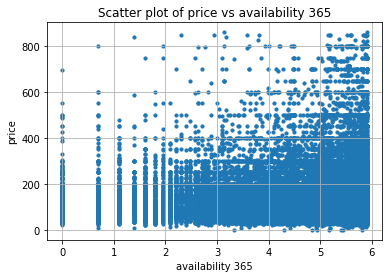

In [ ]:
price = df_c_kaggle.loc[:,"price"].values

#log_price = np.log(price) # Log transformation has been tried

availability_365 = df_c_kaggle.loc[:,"availability_365"].values

log_availability_365 = np.log(availability_365) # Log transformation has been tried

plt.scatter(log_availability_365, price, s=10)
plt.grid();
df_c_kaggle[["price","availability_365"]].corr()

print(df_c_kaggle[["price","availability_365"]].corr())


plt.title("Scatter plot of price vs availability 365")
plt.ylabel("price")
plt.xlabel("availability 365")
plt.show()

#df_c_kaggle["availability_365"].values

# df_c_kaggle.isna().sum()

####Box Plots

`Boxplot of Price`

Max price is :  860
Median price is :  105.0
Mean price is :  138.74690250891624


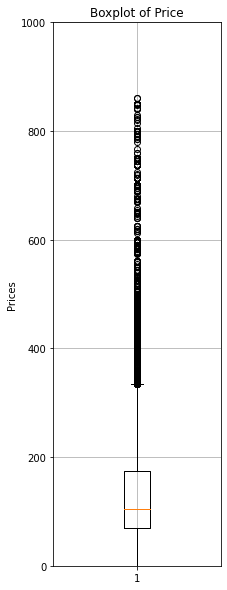

In [ ]:
fig = plt.figure(figsize =(3, 10))
x = df_c_kaggle["price"]

# Creating plot

max_price = df_c_kaggle["price"].max()
median_price = df_c_kaggle["price"].median()
mean_price = df_c_kaggle["price"].mean()

# plt.axvline(df_c_kaggle['price'].median(), 1, 1, c="y")

print("Max price is : ", max_price)
print("Median price is : ", median_price)
print("Mean price is : ", mean_price)
plt.grid();
plt.boxplot(x)
plt.ylim(ymin=0, ymax=1000)
plt.xlabel("")
plt.ylabel("Prices")
plt.title("Boxplot of Price")

# show plot
plt.show()

First of all, we found the max, mean and median values as:
Max price is :  10000
Median price is :  106.0
Mean price is :  152.7206871868289
With the Box Plot we wanted to see the distribution of Price and determine the outliar numbers.

### Additional Dataset (Subway) Visualizations

> Indented block



In our subway additional dataset, we have aimed to see if there was a relation between the price and the distribution of subways in the area that the house is listed. In order to do this, we extracted the coordinates and found the nearest subway for each house listed in Airbnb. This was a great feature and we found out that the price is actually very correlated with the subway locations. This extraction of coordinates is done in the "Feature Extraction" subtitle and explained briefly. There was not enough data to make further visualizations in this dataset. 

### Additional Dataset (POI) Visualizations

In our POI additional dataset, we have emphasized on the distribution of POIs to different neighbourhoods. Additionaly and most importantly we have extracted coordinates from the data and added a new feature to our main dataset which is the nearest POI to every house listed in Airbnb. 

`Borough(x) vs Number of POIs(y)`

['Bronx' 'Manhattan' 'Queens' 'Brooklyn' 'Staten Island']
Borough
Bronx            15
Brooklyn         18
Manhattan        13
Queens           34
Staten Island    16
Name: OBJECTID, dtype: int64


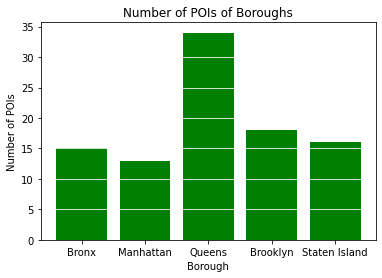

In [ ]:
df_c_poi = df_poi.copy()
boroughs = df_c_poi.loc[:,"Borough"].values
boroughs = pd.Series(boroughs)
boroughs = boroughs.unique()
print(boroughs)

poi_counts = df_c_poi.groupby("Borough").OBJECTID.count()

print(poi_counts)

poi_counts_y = []

for element in boroughs:
  poi_counts_y.append(poi_counts[element])

# room_type_counts = df_c_kaggle.groupby("room_type").host_id.count()
# room_type_counts = list(room_type_counts)
# print(room_type_counts)

plt.bar(boroughs, poi_counts_y, color='green')
plt.xlabel("Borough")
plt.ylabel("Number of POIs")
plt.title("Number of POIs of Boroughs")
plt.grid(axis= 'y', c='w');

plt.show()

`Anno Line3(x) vs Number of Counts(y)`

['Park' 'Cemetery' 'Field' 'Track' 'Corona' 'Golf']
AnnoLine3
Cemetery     4
Corona       1
Field        1
Golf         1
Park        24
Track        1
Name: the_geom, dtype: int64


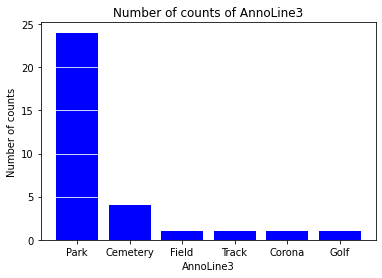

In [ ]:
df_c1_poi = df_poi.copy()
df_c1_poi.dropna(subset = ["AnnoLine3"], inplace=True)
AnnoLine3     = df_c1_poi.loc[:,"AnnoLine3"].values
AnnoLine3     = pd.Series(AnnoLine3)
AnnoLine3     = AnnoLine3.unique()
print(AnnoLine3)

counts = df_c1_poi.groupby("AnnoLine3").the_geom.count()

print(counts)

counts_y = []

for element in AnnoLine3:
  counts_y.append(counts[element])

plt.grid(axis= 'y', c='w');

plt.bar(AnnoLine3, counts_y, color='blue')
plt.xlabel("AnnoLine3")
plt.ylabel("Number of counts")
plt.title("Number of counts of AnnoLine3")

plt.show()

### Additional Dataset (Complaints) Visualizations

In our complaints additional dataset, we have aimed to see if there was a relation between the price and the distribution of crimes in the area that the house is listed. In order to do this we firstly plotted a bar chart to see the distribution of crimes in neighbourhoods such as Brooklyn, Manhattan etc.

####Heatmaps

`Heatmap of Whole Complaints Dataset`

In [ ]:
df_c_complaints = df_complaints.copy()
fig = px.density_mapbox(df_c_complaints, lat='Latitude', lon='Longitude', radius=1,
                        center=dict(lat=df_c_complaints.Latitude.mean(), lon=df_c_complaints.Longitude.mean()), 
                        mapbox_style="open-street-map")
fig.show()

We wanted to see the distribution of the Complaints Dataset.

`Density Map of Felony`

In [ ]:
df_c_complaints[df_c_complaints["LAW_CAT_CD"]=="FELONY"]
fig = px.density_mapbox(df_c_complaints[df_c_complaints["LAW_CAT_CD"]=="FELONY"], lat='Latitude', lon='Longitude', radius=1,
                        center=dict(lat=df_c_complaints[df_c_complaints["LAW_CAT_CD"]=="FELONY"].Latitude.mean(), lon=df_c_complaints[df_c_complaints["LAW_CAT_CD"]=="FELONY"].Longitude.mean()), 
                        mapbox_style="open-street-map")
fig.show()

We wanted to see the distribution of the Felony.

`Heatmap of Misdemeanor`

In [ ]:
fig = px.density_mapbox(df_c_complaints[df_c_complaints["LAW_CAT_CD"]=="MISDEMEANOR"], lat='Latitude', lon='Longitude', radius=1,
                        center=dict(lat=df_c_complaints[df_c_complaints["LAW_CAT_CD"]=="MISDEMEANOR"].Latitude.mean(), lon=df_c_complaints[df_c_complaints["LAW_CAT_CD"]=="MISDEMEANOR"].Longitude.mean()), 
                        mapbox_style="open-street-map")
fig.show()

We wanted to see the distribution of the Misdemeanor.

`Heatmap of Violation`

In [ ]:
fig = px.density_mapbox(df_c_complaints[df_c_complaints["LAW_CAT_CD"]=="VIOLATION"], lat='Latitude', lon='Longitude', radius=1,
                        center=dict(lat=df_c_complaints[df_c_complaints["LAW_CAT_CD"]=="VIOLATION"].Latitude.mean(), lon=df_c_complaints[df_c_complaints["LAW_CAT_CD"]=="VIOLATION"].Longitude.mean()), 
                        mapbox_style="open-street-map")
fig.show()

We wanted to see the distribution of the Violation.

`Helper Function for Preprocess`

In [ ]:
def assign_age_group(age):
  if age == ("<18"):
    return "<18"
  elif (age == "18-24"):
    return "18-24"
  elif (age == "25-44"):
    return "25-44"
  elif (age == "45-64"):
    return "45-64"
  elif (age == "65+"):
    return "65+"
  else:
    return "Missing"

df_c_complaints["VIC_AGE_GROUP"] = df_c_complaints["VIC_AGE_GROUP"].apply(assign_age_group)
df_c_complaints.head()

,CMPLNT_NUM,ADDR_PCT_CD,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,HADEVELOPT,HOUSING_PSA,JURISDICTION_CODE,JURIS_DESC,KY_CD,LAW_CAT_CD,LOC_OF_OCCUR_DESC,OFNS_DESC,PARKS_NM,PATROL_BORO,PD_CD,PD_DESC,PREM_TYP_DESC,RPT_DT,STATION_NAME,SUSP_AGE_GROUP,SUSP_RACE,SUSP_SEX,TRANSIT_DISTRICT,VIC_AGE_GROUP,VIC_RACE,VIC_SEX,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lat_Lon,New Georeferenced Column
0,885776788,66,NaN,12/23/2020,19:50:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,OUTSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,12/23/2020,NaN,NaN,NaN,NaN,NaN,18-24,BLACK,M,986633,167258,40.625769,-73.991417,"(40.62576896100006, -73.99141682199996)",POINT (-73.99141682199996 40.62576896100006)
1,350637195,77,NaN,12/21/2020,01:10:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,INSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,12/21/2020,NaN,NaN,NaN,NaN,NaN,25-44,BLACK,M,1003606,185050,40.674583,-73.930222,"(40.67458330800008, -73.93022154099998)",POINT (-73.93022154099998 40.67458330800008)
2,347843168,43,BRONX,11/22/2020,22:00:00,NaN,NaN,COMPLETED,NaN,NaN,0.0,N.Y. POLICE DEPT,104,FELONY,NaN,RAPE,NaN,PATROL BORO BRONX,157.0,RAPE 1,STREET,11/23/2020,NaN,UNKNOWN,UNKNOWN,U,NaN,25-44,BLACK,F,1020316,239179,40.823101,-73.869690,"(40.82310129900002, -73.86969046099993)",POINT (-73.86969046099993 40.82310129900002)
3,197941396,47,NaN,11/22/2020,09:50:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,INSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,11/22/2020,NaN,25-44,BLACK,M,NaN,25-44,BLACK,F,1026387,262634,40.887451,-73.847608,"(40.88745131300004, -73.84760778699997)",POINT (-73.84760778699997 40.88745131300004)
4,298404927,25,NaN,11/21/2020,15:38:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. HOUSING POLICE,101,FELONY,OUTSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,11/21/2020,NaN,NaN,NaN,NaN,NaN,18-24,BLACK HISPANIC,M,1003396,230824,40.800222,-73.930848,"(40.80022202900005, -73.93084834199995)",POINT (-73.93084834199995 40.80022202900005)


`This is for the NaNs and Unknowns`

In [ ]:
df_c_complaints = df_c_complaints.replace("UNKNOWN",np.nan) #RUN THIS CELL ONLY ONCE!
df_c_complaints.fillna("Missing")
df_c_complaints.head()

,CMPLNT_NUM,ADDR_PCT_CD,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,HADEVELOPT,HOUSING_PSA,JURISDICTION_CODE,JURIS_DESC,KY_CD,LAW_CAT_CD,LOC_OF_OCCUR_DESC,OFNS_DESC,PARKS_NM,PATROL_BORO,PD_CD,PD_DESC,PREM_TYP_DESC,RPT_DT,STATION_NAME,SUSP_AGE_GROUP,SUSP_RACE,SUSP_SEX,TRANSIT_DISTRICT,VIC_AGE_GROUP,VIC_RACE,VIC_SEX,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lat_Lon,New Georeferenced Column
0,885776788,66,NaN,12/23/2020,19:50:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,OUTSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,12/23/2020,NaN,NaN,NaN,NaN,NaN,18-24,BLACK,M,986633,167258,40.625769,-73.991417,"(40.62576896100006, -73.99141682199996)",POINT (-73.99141682199996 40.62576896100006)
1,350637195,77,NaN,12/21/2020,01:10:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,INSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,12/21/2020,NaN,NaN,NaN,NaN,NaN,25-44,BLACK,M,1003606,185050,40.674583,-73.930222,"(40.67458330800008, -73.93022154099998)",POINT (-73.93022154099998 40.67458330800008)
2,347843168,43,BRONX,11/22/2020,22:00:00,NaN,NaN,COMPLETED,NaN,NaN,0.0,N.Y. POLICE DEPT,104,FELONY,NaN,RAPE,NaN,PATROL BORO BRONX,157.0,RAPE 1,STREET,11/23/2020,NaN,NaN,NaN,U,NaN,25-44,BLACK,F,1020316,239179,40.823101,-73.869690,"(40.82310129900002, -73.86969046099993)",POINT (-73.86969046099993 40.82310129900002)
3,197941396,47,NaN,11/22/2020,09:50:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,INSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,11/22/2020,NaN,25-44,BLACK,M,NaN,25-44,BLACK,F,1026387,262634,40.887451,-73.847608,"(40.88745131300004, -73.84760778699997)",POINT (-73.84760778699997 40.88745131300004)
4,298404927,25,NaN,11/21/2020,15:38:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. HOUSING POLICE,101,FELONY,OUTSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,11/21/2020,NaN,NaN,NaN,NaN,NaN,18-24,BLACK HISPANIC,M,1003396,230824,40.800222,-73.930848,"(40.80022202900005, -73.93084834199995)",POINT (-73.93084834199995 40.80022202900005)


In [ ]:
df_c_complaints[df_c_complaints["LAW_CAT_CD"]=="FELONY"].count()


CMPLNT_NUM                  134987
ADDR_PCT_CD                 134987
BORO_NM                     134522
CMPLNT_FR_DT                134987
CMPLNT_FR_TM                134987
CMPLNT_TO_DT                123763
CMPLNT_TO_TM                123783
CRM_ATPT_CPTD_CD            134987
HADEVELOPT                     482
HOUSING_PSA                   8986
JURISDICTION_CODE           134524
JURIS_DESC                  134987
KY_CD                       134987
LAW_CAT_CD                  134987
LOC_OF_OCCUR_DESC           112346
OFNS_DESC                   134982
PARKS_NM                      1071
PATROL_BORO                 134524
PD_CD                       134524
PD_DESC                     134524
PREM_TYP_DESC               134268
RPT_DT                      134987
STATION_NAME                  2971
SUSP_AGE_GROUP               50982
SUSP_RACE                    64333
SUSP_SEX                     99139
TRANSIT_DISTRICT              2971
VIC_AGE_GROUP               134987
VIC_RACE            

In [ ]:
df_c_complaints[df_c_complaints["LAW_CAT_CD"]=="VIOLATION"].count()

CMPLNT_NUM                  67255
ADDR_PCT_CD                 67255
BORO_NM                     67250
CMPLNT_FR_DT                67255
CMPLNT_FR_TM                67255
CMPLNT_TO_DT                59580
CMPLNT_TO_TM                59616
CRM_ATPT_CPTD_CD            67255
HADEVELOPT                    350
HOUSING_PSA                  7599
JURISDICTION_CODE           67255
JURIS_DESC                  67255
KY_CD                       67255
LAW_CAT_CD                  67255
LOC_OF_OCCUR_DESC           60767
OFNS_DESC                   67254
PARKS_NM                      280
PATROL_BORO                 67255
PD_CD                       67255
PD_DESC                     67255
PREM_TYP_DESC               67148
RPT_DT                      67255
STATION_NAME                  982
SUSP_AGE_GROUP              39842
SUSP_RACE                   51793
SUSP_SEX                    63549
TRANSIT_DISTRICT              982
VIC_AGE_GROUP               67255
VIC_RACE                    63680
VIC_SEX       

In [ ]:
df_c_complaints[df_c_complaints["LAW_CAT_CD"]=="MISDEMEANOR"].count()


CMPLNT_NUM                  211170
ADDR_PCT_CD                 211170
BORO_NM                     211155
CMPLNT_FR_DT                211170
CMPLNT_FR_TM                211170
CMPLNT_TO_DT                190965
CMPLNT_TO_TM                191034
CRM_ATPT_CPTD_CD            211170
HADEVELOPT                     738
HOUSING_PSA                  14382
JURISDICTION_CODE           211170
JURIS_DESC                  211170
KY_CD                       211170
LAW_CAT_CD                  211170
LOC_OF_OCCUR_DESC           174213
OFNS_DESC                   211170
PARKS_NM                      1325
PATROL_BORO                 211170
PD_CD                       211170
PD_DESC                     211170
PREM_TYP_DESC               210824
RPT_DT                      211170
STATION_NAME                  3280
SUSP_AGE_GROUP               83132
SUSP_RACE                   106358
SUSP_SEX                    155862
TRANSIT_DISTRICT              3280
VIC_AGE_GROUP               211170
VIC_RACE            

IN THE POI DATASET, COORDINATES ARE GIVEN AS STRING. WE SPLIT LONGITUDE AND LATITUDE AND CONVERT THEM TO FLOAT NUMBERS. AFTER THAT WE ADD THEM AS SEPARATE COLUMN IN THE DATASET

In [ ]:
df_c_poi["longitude"] , df_c_poi["latitude"] = df_c_poi["the_geom"].apply(longConverter) , df_c_poi["the_geom"].apply(latConverter)
df_c_poi.head()

,the_geom,OBJECTID,Id,Name,Stacked,AnnoLine1,AnnoLine3,Borough,AnnoLine4,AnnoLine2a,Angle,longitude,latitude
0,POINT (-73.88895811640342 40.8962098695574),1,90,Van Cortlandt Park,3,Van,Park,Bronx,NaN,Cortlandt,0,-73.888958,40.896210
1,POINT (-73.87165102682086 40.88987947152594),2,95,Woodlawn Cemetery,2,Woodlawn,NaN,Bronx,NaN,Cemetery,0,-73.871651,40.889879
2,POINT (-73.8386418872537 40.88696522165708),3,81,Seton Falls Park,3,Seton,Park,Bronx,NaN,Falls,0,-73.838642,40.886965
3,POINT (-73.80980242290379 40.87798554992497),4,69,Pelham Bay Park,3,Pelham,Park,Bronx,NaN,Bay,0,-73.809802,40.877986
4,POINT (-73.87830775950145 40.864423947038276),5,8,Botanical Garden,2,Botanical,NaN,Bronx,NaN,Garden,0,-73.878308,40.864424


IN THE SUBWAY DATASET, COORDINATES ARE GIVEN AS STRING. WE SPLIT LONGITUDE AND LATITUDE AND CONVERT THEM TO FLOAT NUMBERS. AFTER THAT WE ADD THEM AS SEPARATE COLUMN IN THE DATASET

In [ ]:
df_subway["longitude"] , df_subway["latitude"] = df_subway["the_geom"].apply(longConverter) , df_subway["the_geom"].apply(latConverter)
df_subway.head()

,URL,OBJECTID,NAME,the_geom,LINE,NOTES,longitude,latitude
0,http://web.mta.info/nyct/service/,1,Astor Pl,POINT (-73.99106999861966 40.73005400028978),4-6-6 Express,"4 nights, 6-all times, 6 Express-weekdays AM s...",-73.991070,40.730054
1,http://web.mta.info/nyct/service/,2,Canal St,POINT (-74.00019299927328 40.71880300107709),4-6-6 Express,"4 nights, 6-all times, 6 Express-weekdays AM s...",-74.000193,40.718803
2,http://web.mta.info/nyct/service/,3,50th St,POINT (-73.98384899986625 40.76172799961419),1-2,"1-all times, 2-nights",-73.983849,40.761728
3,http://web.mta.info/nyct/service/,4,Bergen St,POINT (-73.97499915116808 40.68086213682956),2-3-4,"4-nights, 3-all other times, 2-all times",-73.974999,40.680862
4,http://web.mta.info/nyct/service/,5,Pennsylvania Ave,POINT (-73.89488591154061 40.66471445143568),3-4,"4-nights, 3-all other times",-73.894886,40.664714


# FEATURE EXTRACTION

In this part, using the additional datasets;

Subway Dataset: We find the distance from the houses of our main dataset to the *nearest subway locations* and add them as new columnns to our main dataset. 

POI Dataset: Same goes for places of interest (POI in the POI dataset). We find the *nearest POI locations*.

Complaints Dataset: We also find the *number of complaints*, and *number of felonies* (by extracting the felonies, the most serious complaint type in the complaints dataset) in an area around the location of each of the houses in our main dataset. 

## Find the distance to the nearest subway location

`We find the distance to the nearest subway location and add it and their indices as a new variable.`

In [ ]:
from sklearn.neighbors import BallTree
from math import radians

listing_locs = df_c_kaggle[["longitude", "latitude"]].values
subway_locs = df_subway[["longitude", "latitude"]].values

# radians için bir fonksiyon
r = np.vectorize(lambda x: radians(x))
# lat-lng değerlerini radians'a çevir
listing_locs = r(listing_locs)
subway_locs = r(subway_locs)
#print(subway_locs)
# ballTree'ye subway listesini gir
# haversine, yeryüzü üzerindeki noktalar arasındaki mesafeler için
tree = BallTree(subway_locs, metric="haversine", leaf_size=2)

# oluşan tree'den listing loc'ları için en yakın noktaları çek
nearest_subways, nearest_subway_indices = tree.query(listing_locs) 

df_c_kaggle["nearest_subway_indices"]= nearest_subway_indices
df_c_kaggle["nearest_subway_indices"].unique()

for i in range(len(df_c_kaggle)):
  df_c_kaggle.loc[i,"nearest_subway_distance"] = haversine(df_c_kaggle.loc[i],df_subway.loc[nearest_subway_indices[i]]["longitude"],df_subway.loc[nearest_subway_indices[i]]["latitude"])



# df_c_kaggle["nearest_subway_indices"].shape

# print(nearest_subways)


In [ ]:


df_c_kaggle.head()

,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,availability_365,nearest_subway_indices,nearest_subway_distance
0,2787,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.210000,365,108,0.465043
1,2845,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.380000,355,59,0.093298
2,4632,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,1.373221,365,168,0.586601
3,4869,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.640000,194,69,0.417059
4,7192,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.100000,0,449,0.388443


### Histogram of Nearest Subway distance 




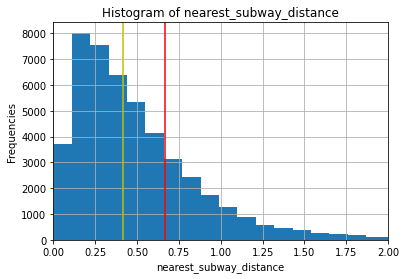

In [ ]:
x = df_c_kaggle["nearest_subway_distance"]
plt.hist(x, bins=200)
# plt.xlim(xmin=0, xmax=4)
plt.xlim(xmin=0, xmax=2)

plt.xlabel("nearest_subway_distance")
plt.ylabel("Frequencies")
plt.title("Histogram of nearest_subway_distance")
plt.axvline(df_c_kaggle['nearest_subway_distance'].mean(), 0, 1, c="r")
plt.axvline(df_c_kaggle['nearest_subway_distance'].median(), 0, 1, c="y")

plt.grid();


plt.show()

In this figure, we have the histogram of frequences of nearest subway distances, we see that nearest subway distances tend to take place most frequently around the distance of 0.2 - 0.25 kms. We limited the x axis by 2 to see the distribution clearer and open. After 2, it remains constant at a low frequency. Thus, we will mostly deal with distances of 0.2 - 0.3.
The yellow line stands for the median and red line stands for mean. We see clearly that the distribution is skewed to the right. 

### Scatter plot of price vs Nearest Subway Distance

The correlation between price and nearest_subway_distance is: 
                            price  nearest_subway_distance
price                    1.000000                -0.031168
nearest_subway_distance -0.031168                 1.000000


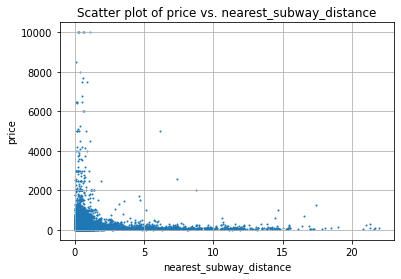

In [ ]:
price = df_c_kaggle.loc[:,"price"].values

#log_price = np.log(price) # Log transformation has been tried

nearest_subway_distance = df_c_kaggle.loc[:,"nearest_subway_distance"].values

#log_number_of_reviews = np.log("number_of_reviews) # Log transformation has been tried

plt.scatter(nearest_subway_distance,price, s=1)
print("The correlation between price and nearest_subway_distance is: ")
print(df_c_kaggle[["price", "nearest_subway_distance"]].corr())
plt.grid();
plt.title("Scatter plot of price vs. nearest_subway_distance")

plt.ylabel("price")
plt.xlabel("nearest_subway_distance")
plt.show()

In this figure, we have the scatter plot of price vs nearest subway distances. We see that we have a negative low correlation between the variables. This is probably mainly because we have a really dense some random values in the lower axises and this makes the correlation low.

## Find the distance to the nearest POI location

We find the distance to the nearest POI locations and add it and their indices as a new variable.



In [ ]:
listing_locs = df_c_kaggle[["longitude", "latitude"]].values
poi_locs = df_c_poi[["longitude", "latitude"]].values

# radians için bir fonksiyon
r = np.vectorize(lambda x: radians(x))
# lat-lng değerlerini radians'a çevir
listing_locs = r(listing_locs)
poi_locs = r(poi_locs)
#print(subway_locs)
# ballTree'ye subway listesini gir
# haversine, yeryüzü üzerindeki noktalar arasındaki mesafeler için
tree = BallTree(poi_locs, metric="haversine",leaf_size=2)

# oluşan tree'den listing loc'ları için en yakın noktaları çek
nearest_pois, nearest_poi_indices = tree.query(listing_locs) 

df_c_kaggle["nearest_poi_indices"]= nearest_poi_indices
df_c_kaggle["nearest_poi_indices"].unique()

for i in range(len(df_c_kaggle)):
  df_c_kaggle.loc[i,"nearest_poi_distance"] = haversine(df_c_kaggle.loc[i],df_c_poi.loc[nearest_poi_indices[i]]["longitude"],df_c_poi.loc[nearest_poi_indices[i]]["latitude"])



In [ ]:
df_c_kaggle.head()

,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance
0,2787,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.210000,365,108,0.465043,28,1.554023
1,2845,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.380000,355,59,0.093298,21,0.516611
2,4632,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,1.373221,365,168,0.586601,16,0.621381
3,4869,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.640000,194,69,0.417059,27,1.772545
4,7192,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.100000,0,449,0.388443,16,0.560944


### Histogram of Nearest Place of Interest (POI) Distance

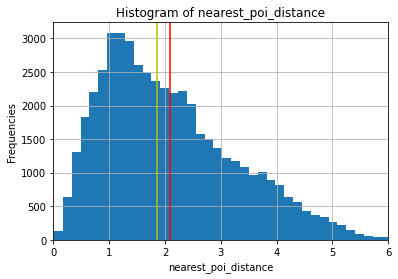

In [ ]:
x = df_c_kaggle["nearest_poi_distance"]
plt.hist(x, bins=50)
plt.xlim(xmin=0, xmax=6)
plt.xlabel("nearest_poi_distance")
plt.ylabel("Frequencies")
plt.title("Histogram of nearest_poi_distance")
plt.axvline(df_c_kaggle['nearest_poi_distance'].mean(), 0, 1, c="r")
plt.axvline(df_c_kaggle['nearest_poi_distance'].median(), 0, 1, c="y")

plt.grid();

plt.show()

In this figure, we have the histogram of frequences of nearest poi distances, we see that nearest subway distances tend to take place most frequently around the distance around 1 kms. We limited the x axis by 6 to see the distribution clearer and open and get to rid of the outliers. Thus, we will mostly deal with distances around 0.5 to 3 in our project.
The yellow line stands for the median and red line stands for mean. We see clearly that the distribution is skewed to the right. 

### Scatter plot of Price vs. Nearest Poi Distance

The correlation between price and nearest_poi_distance is: 
                         price  nearest_poi_distance
price                 1.000000             -0.051331
nearest_poi_distance -0.051331              1.000000


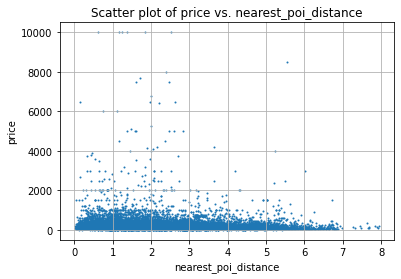

In [ ]:
price = df_c_kaggle.loc[:,"price"].values

#log_price = np.log(price) # Log transformation has been tried

nearest_poi_distance = df_c_kaggle.loc[:,"nearest_poi_distance"].values

#log_number_of_reviews = np.log("number_of_reviews) # Log transformation has been tried

plt.scatter(nearest_poi_distance,price, s=1)
print("The correlation between price and nearest_poi_distance is: ")
print(df_c_kaggle[["price", "nearest_poi_distance"]].corr())
plt.grid();
plt.title("Scatter plot of price vs. nearest_poi_distance")

plt.ylabel("price")
plt.xlabel("nearest_poi_distance")
plt.show()

In this figure, we have the scatter plot of price vs nearest poi distances. We see that we have a low negative correlation between the variables. This is probably mainly because we have a really dense some random values in the points of the lower axises and this makes the correlation low. This is lonely is not enough to explain the price behaviour but may be up to something when use with other variables in our machine learning model.

## Find the number of complaints in an area

In this part, we now find the number of complaints in an area around each of the data points of houses in our main dataset and add it as a variable to our main dataset.



In [ ]:
listing_locs = df_c_kaggle[["longitude", "latitude"]].values
complaint_locs = df_c_complaints[["Longitude", "Latitude"]].values

# radians için bir fonksiyon
r = np.vectorize(lambda x: radians(x))
# lat-lng değerlerini radians'a çevir
listing_locs = r(listing_locs)
complaint_locs = r(complaint_locs)
#print(subway_locs)
# ballTree'ye subway listesini gir
# haversine, yeryüzü üzerindeki noktalar arasındaki mesafeler için
tree = BallTree(complaint_locs, metric="haversine",leaf_size=2)

# oluşan tree'den listing loc'ları için en yakın noktaları çek
#nearest_complaints, nearest_complaint_indices = tree.query(listing_locs) 
df_c_kaggle["number_of_crimes"] = tree.query_radius(listing_locs,r=0.00005,count_only=True) #tek sıkıntı radius u hangi değer yapacağımız!!!
#df_c_kaggle["nearest_complaint_indices"]= nearest_complaint_indices

#for i in range(len(df_c_kaggle)):
#  df_c_kaggle.loc[i,"nearest_complaint_distance"] = haversine(df_c_kaggle.loc[i],df_c_complaints.loc[nearest_complaint_indices[i]]["Longitude"],df_c_complaints.loc[nearest_complaint_indices[i]]["Latitude"])

In [ ]:
df_c_kaggle.head()

,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes
0,2787,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.210000,365,108,0.465043,28,1.554023,374
1,2845,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.380000,355,59,0.093298,21,0.516611,2068
2,4632,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,1.373221,365,168,0.586601,16,0.621381,2204
3,4869,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.640000,194,69,0.417059,27,1.772545,1242
4,7192,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.100000,0,449,0.388443,16,0.560944,2342


### Histogram of Number of Crimes
 

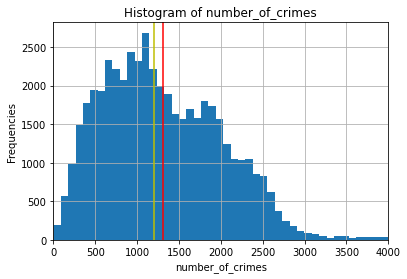

In [ ]:
x = df_c_kaggle["number_of_crimes"]
plt.hist(x, bins=50)
plt.xlim(xmin=0, xmax=4000)
plt.xlabel("number_of_crimes")
plt.ylabel("Frequencies")
plt.title("Histogram of number_of_crimes")
plt.axvline(df_c_kaggle['number_of_crimes'].mean(), 0, 1, c="r")
plt.axvline(df_c_kaggle['number_of_crimes'].median(), 0, 1, c="y")

plt.grid();

plt.show()

In this figure, we have the histogram of frequences of number of crimes, we see that number of crimes tend to take place most frequently around 1000-1200. Thus, we will mostly deal with distances around 500-2000 in our project.
The yellow line stands for the median and red line stands for mean. We see clearly that the distribution is skewed to the right which means that we have some extra amounts of crimes at really low frequences.

### Scatter plot of price vs Number of Crimes

The correlation between price and number_of_crimes is: 
                     price  number_of_crimes
price             1.000000          0.087956
number_of_crimes  0.087956          1.000000


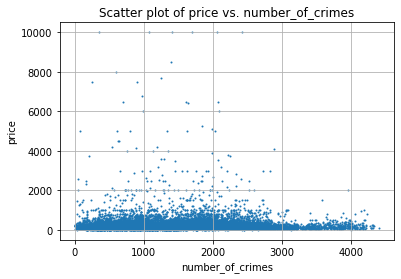

In [ ]:
price = df_c_kaggle.loc[:,"price"].values

#log_price = np.log(price) # Log transformation has been tried

number_of_crimes = df_c_kaggle.loc[:,"number_of_crimes"].values

#log_number_of_reviews = np.log("number_of_reviews) # Log transformation has been tried

plt.scatter(number_of_crimes,price, s=1)
print("The correlation between price and number_of_crimes is: ")
print(df_c_kaggle[["price", "number_of_crimes"]].corr())
plt.grid();
plt.title("Scatter plot of price vs. number_of_crimes")

plt.ylabel("price")
plt.xlabel("number_of_crimes")
plt.show()

In this figure, we have the scatter plot of price vs. number of crimes in the areas around the the data points of our houses. We see that we have a low positive correlation between the variables. This is probably mainly because we have a really dense some random values in the points until number of crimes reach around 2500 and this makes the correlation low. This is lonely is not enough to explain the price behaviour but may be up to something when use with other variables in our machine learning model as well.

In [ ]:
df_c_complaints_felony = df_c_complaints.copy()
index = df_c_complaints_felony.index
condition = (df_c_complaints_felony["LAW_CAT_CD"]=="VIOLATION") | (df_c_complaints_felony["LAW_CAT_CD"]== "MISDEMEANOR")
Drop_indices = index[condition]

df_c_complaints_felony = df_c_complaints_felony.drop(Drop_indices)


# df_c_complaints_felony = df_c_complaints[df_c_complaints["LAW_CAT_CD"] == "FELONY"]
df_c_complaints_felony.head(10)


,CMPLNT_NUM,ADDR_PCT_CD,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,HADEVELOPT,HOUSING_PSA,JURISDICTION_CODE,JURIS_DESC,KY_CD,LAW_CAT_CD,LOC_OF_OCCUR_DESC,OFNS_DESC,PARKS_NM,PATROL_BORO,PD_CD,PD_DESC,PREM_TYP_DESC,RPT_DT,STATION_NAME,SUSP_AGE_GROUP,SUSP_RACE,SUSP_SEX,TRANSIT_DISTRICT,VIC_AGE_GROUP,VIC_RACE,VIC_SEX,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lat_Lon,New Georeferenced Column
0,885776788,66,NaN,12/23/2020,19:50:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,OUTSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,12/23/2020,NaN,NaN,NaN,NaN,NaN,18-24,BLACK,M,986633,167258,40.625769,-73.991417,"(40.62576896100006, -73.99141682199996)",POINT (-73.99141682199996 40.62576896100006)
1,350637195,77,NaN,12/21/2020,01:10:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,INSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,12/21/2020,NaN,NaN,NaN,NaN,NaN,25-44,BLACK,M,1003606,185050,40.674583,-73.930222,"(40.67458330800008, -73.93022154099998)",POINT (-73.93022154099998 40.67458330800008)
2,347843168,43,BRONX,11/22/2020,22:00:00,NaN,NaN,COMPLETED,NaN,NaN,0.0,N.Y. POLICE DEPT,104,FELONY,NaN,RAPE,NaN,PATROL BORO BRONX,157.0,RAPE 1,STREET,11/23/2020,NaN,NaN,NaN,U,NaN,25-44,BLACK,F,1020316,239179,40.823101,-73.869690,"(40.82310129900002, -73.86969046099993)",POINT (-73.86969046099993 40.82310129900002)
3,197941396,47,NaN,11/22/2020,09:50:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,INSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,11/22/2020,NaN,25-44,BLACK,M,NaN,25-44,BLACK,F,1026387,262634,40.887451,-73.847608,"(40.88745131300004, -73.84760778699997)",POINT (-73.84760778699997 40.88745131300004)
4,298404927,25,NaN,11/21/2020,15:38:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. HOUSING POLICE,101,FELONY,OUTSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,11/21/2020,NaN,NaN,NaN,NaN,NaN,18-24,BLACK HISPANIC,M,1003396,230824,40.800222,-73.930848,"(40.80022202900005, -73.93084834199995)",POINT (-73.93084834199995 40.80022202900005)
5,549342890,44,NaN,11/05/2020,09:40:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,OUTSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,11/05/2020,NaN,NaN,NaN,NaN,NaN,18-24,WHITE HISPANIC,M,1006434,244344,40.837324,-73.919831,"(40.83732351100008, -73.91983075699994)",POINT (-73.91983075699994 40.83732351100008)
6,921351410,28,NaN,11/04/2020,09:14:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,OUTSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,11/04/2020,NaN,25-44,BLACK,M,NaN,25-44,BLACK,M,997670,230545,40.799467,-73.951531,"(40.799466801000044, -73.95153053599995)",POINT (-73.95153053599995 40.799466801000044)
7,452350235,44,NaN,11/02/2020,18:30:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,INSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,11/02/2020,NaN,<18,WHITE HISPANIC,M,NaN,18-24,BLACK,F,1006999,245897,40.841585,-73.917784,"(40.841584606000026, -73.91778363799993)",POINT (-73.91778363799993 40.841584606000026)
8,714801710,110,NaN,11/01/2020,01:20:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,OUTSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,11/01/2020,NaN,NaN,NaN,NaN,NaN,25-44,WHITE HISPANIC,M,1016573,210045,40.743151,-73.883355,"(40.74315076400006, -73.88335454299995)",POINT (-73.88335454299995 40.74315076400006)
9,985956017,63,NaN,10/31/2020,01:50:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,OUTSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,10/31/2020,NaN,NaN,NaN,NaN,NaN,25-44,BLACK,M,1005075,169926,40.633068,-73.924972,"(40.63306790400002, -73.92497238099996)",POINT (-73.92497238099996 40.63306790400002)


Above, we drop the other instances of complaints and have felonies at our hand as the only complaint type.

## Find the number of felonies in an area

In this part, this time, we find the number of felonies in an area around each of the data points of houses in our main dataset and add it as a variable to our main dataset as well.


In [ ]:
listing_locs = df_c_kaggle[["longitude", "latitude"]].values
complaint_locs = df_c_complaints_felony[["Longitude", "Latitude"]].values

# radians için bir fonksiyon
r = np.vectorize(lambda x: radians(x))
# lat-lng değerlerini radians'a çevir
listing_locs = r(listing_locs)
complaint_locs = r(complaint_locs)
#print(subway_locs)
# ballTree'ye subway listesini gir
# haversine, yeryüzü üzerindeki noktalar arasındaki mesafeler için
tree = BallTree(complaint_locs, metric="haversine",leaf_size=2)

# oluşan tree'den listing loc'ları için en yakın noktaları çek
#nearest_complaints, nearest_complaint_indices = tree.query(listing_locs) 
df_c_kaggle["number_of_felonies"] = tree.query_radius(listing_locs,r=0.0001,count_only=True) #tek sıkıntı radius u hangi değer yapacağımız!!!
#df_c_kaggle["nearest_complaint_indices"]= nearest_complaint_indices

#for i in range(len(df_c_kaggle)):
#  df_c_kaggle.loc[i,"nearest_complaint_distance"] = haversine(df_c_kaggle.loc[i],df_c_complaints.loc[nearest_complaint_indices[i]]["Longitude"],df_c_complaints.loc[nearest_complaint_indices[i]]["Latitude"])

In [ ]:
df_c_kaggle.head(5)

,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,2787,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.210000,365,108,0.465043,28,1.554023,374,483
1,2845,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.380000,355,59,0.093298,21,0.516611,2068,3243
2,4632,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,1.373221,365,168,0.586601,16,0.621381,2204,3230
3,4869,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.640000,194,69,0.417059,27,1.772545,1242,1188
4,7192,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.100000,0,449,0.388443,16,0.560944,2342,3105


### Histogram of Number of Felonies

Mean:  1558.9915737805502
Median:  1411.0


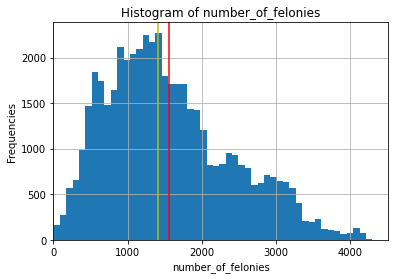

In [ ]:
x = df_c_kaggle["number_of_felonies"]
plt.hist(x, bins=50)
plt.xlim(xmin=0,)
plt.xlabel("number_of_felonies")
plt.ylabel("Frequencies")
plt.title("Histogram of number_of_felonies")
plt.axvline(df_c_kaggle['number_of_felonies'].mean(), 0, 1, c="r")
plt.axvline(df_c_kaggle['number_of_felonies'].median(), 0, 1, c="y")
print("Mean: ", df_c_kaggle['number_of_felonies'].mean())
print("Median: ", df_c_kaggle['number_of_felonies'].median())


plt.grid();

plt.show()

In this figure, we have the histogram of frequences of number of felonies, we see that number of felonies tend to take place most frequently around 1400s. Thus, we will mostly deal with distances around 500-2000 in our project.
The yellow line stands for the median and red line stands for mean. We see clearly that the distribution is skewed to the right which means that we have extra amounts of felonies at really low frequences.

### Scatter plot of price vs number of felonies

The correlation between price and number_of_felonies is: 
                       price  number_of_felonies
price               1.000000            0.103194
number_of_felonies  0.103194            1.000000


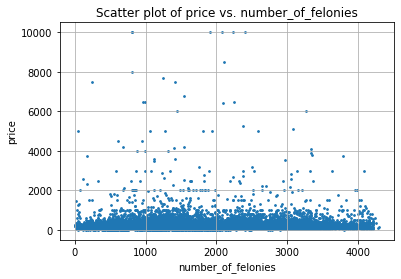

In [ ]:
price = df_c_kaggle.loc[:,"price"].values

#log_price = np.log(price) # Log transformation has been tried

number_of_felonies = df_c_kaggle.loc[:,"number_of_felonies"].values

#log_number_of_reviews = np.log("number_of_reviews) # Log transformation has been tried

plt.scatter(number_of_felonies, price, s=3)
print("The correlation between price and number_of_felonies is: ")
print(df_c_kaggle[["price", "number_of_felonies"]].corr())
plt.grid();
plt.title("Scatter plot of price vs. number_of_felonies")

plt.ylabel("price")
plt.xlabel("number_of_felonies")
plt.show()

In this figure, we have the scatter plot of price vs. number of felonies in the areas around the the data points of our houses. We see that we have a low positive correlation of 10.3% between the variables. This is probably mainly because we have a really dense some random values in the points and this makes the correlation low. This is lonely is not enough to explain the price behaviour but may be up to something when use with other variables in our machine learning model again as well.

In [ ]:
df_c_complaints_felony.head()

,CMPLNT_NUM,ADDR_PCT_CD,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,HADEVELOPT,HOUSING_PSA,JURISDICTION_CODE,JURIS_DESC,KY_CD,LAW_CAT_CD,LOC_OF_OCCUR_DESC,OFNS_DESC,PARKS_NM,PATROL_BORO,PD_CD,PD_DESC,PREM_TYP_DESC,RPT_DT,STATION_NAME,SUSP_AGE_GROUP,SUSP_RACE,SUSP_SEX,TRANSIT_DISTRICT,VIC_AGE_GROUP,VIC_RACE,VIC_SEX,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lat_Lon,New Georeferenced Column
0,885776788,66,NaN,12/23/2020,19:50:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,OUTSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,12/23/2020,NaN,NaN,NaN,NaN,NaN,18-24,BLACK,M,986633,167258,40.625769,-73.991417,"(40.62576896100006, -73.99141682199996)",POINT (-73.99141682199996 40.62576896100006)
1,350637195,77,NaN,12/21/2020,01:10:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,INSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,12/21/2020,NaN,NaN,NaN,NaN,NaN,25-44,BLACK,M,1003606,185050,40.674583,-73.930222,"(40.67458330800008, -73.93022154099998)",POINT (-73.93022154099998 40.67458330800008)
2,347843168,43,BRONX,11/22/2020,22:00:00,NaN,NaN,COMPLETED,NaN,NaN,0.0,N.Y. POLICE DEPT,104,FELONY,NaN,RAPE,NaN,PATROL BORO BRONX,157.0,RAPE 1,STREET,11/23/2020,NaN,NaN,NaN,U,NaN,25-44,BLACK,F,1020316,239179,40.823101,-73.869690,"(40.82310129900002, -73.86969046099993)",POINT (-73.86969046099993 40.82310129900002)
3,197941396,47,NaN,11/22/2020,09:50:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. POLICE DEPT,101,FELONY,INSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,11/22/2020,NaN,25-44,BLACK,M,NaN,25-44,BLACK,F,1026387,262634,40.887451,-73.847608,"(40.88745131300004, -73.84760778699997)",POINT (-73.84760778699997 40.88745131300004)
4,298404927,25,NaN,11/21/2020,15:38:00,NaN,NaN,COMPLETED,NaN,NaN,NaN,N.Y. HOUSING POLICE,101,FELONY,OUTSIDE,MURDER & NON-NEGL. MANSLAUGHTER,NaN,NaN,NaN,NaN,NaN,11/21/2020,NaN,NaN,NaN,NaN,NaN,18-24,BLACK HISPANIC,M,1003396,230824,40.800222,-73.930848,"(40.80022202900005, -73.93084834199995)",POINT (-73.93084834199995 40.80022202900005)


#Hypothesis Testing

In [ ]:
#Burada df_c_kaggle ı yeniden import edebiliriz...
# df_c_kaggle = pd.read_csv("df_c_kaggle.csv")
df_c_kaggle = pd.read_csv(join(path_prefix, "df_c_kaggle.csv"))

df_c_kaggle.head()

,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.210000,6,365,108,0.465043,28,1.554023,374,483
1,1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.380000,2,355,59,0.093298,21,0.516611,2068,3243
2,2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,1.373221,1,365,168,0.586601,16,0.621381,2204,3230
3,3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.640000,1,194,69,0.417059,27,1.772545,1242,1188
4,4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.100000,1,0,449,0.388443,16,0.560944,2342,3105


Room Types

In [ ]:
#Create data frame for Private room
df_private_room = df_c_kaggle[df_c_kaggle['room_type']== 'Private room']
df_private_room = df_private_room.reset_index(drop=True)
df_private_room.head()

,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.210000,6,365,108,0.465043,28,1.554023,374,483
1,2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,1.373221,1,365,168,0.586601,16,0.621381,2204,3230
2,6,5121,BlissArtsSpace!,7356,Garon,Brooklyn,Bedford-Stuyvesant,40.68688,-73.95596,Private room,60,45,49,2017-10-05,0.400000,1,0,287,0.698437,25,3.795273,1153,1405
3,7,5178,Large Furnished Room Near B'way,8967,Shunichi,Manhattan,Hell's Kitchen,40.76489,-73.98493,Private room,79,2,430,2019-06-24,3.470000,1,220,346,0.284655,20,0.434829,2174,2696
4,8,5203,Cozy Clean Guest Room - Family Apt,7490,MaryEllen,Manhattan,Upper West Side,40.80178,-73.96723,Private room,79,2,118,2017-07-21,0.990000,1,0,165,0.245157,19,2.104260,1660,1049


In [ ]:
#Create data frame for Entire home/apt
df_entire_home = df_c_kaggle[df_c_kaggle['room_type']== 'Entire home/apt']
df_entire_home = df_entire_home.reset_index(drop=True)
df_entire_home.head()

,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355,59,0.093298,21,0.516611,2068,3243
1,3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194,69,0.417059,27,1.772545,1242,1188
2,4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0,449,0.388443,16,0.560944,2342,3105
3,5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,2019-06-22,0.59,1,129,203,0.427031,21,1.284619,1759,1694
4,9,5238,Cute & Cozy Lower East Side 1 bdrm,7549,Ben,Manhattan,Chinatown,40.71344,-73.99037,Entire home/apt,150,1,160,2019-06-09,1.33,4,188,368,0.048898,23,2.502507,1616,1976


In [ ]:
#Create data frame for Shared room
df_shared_room = df_c_kaggle[df_c_kaggle['room_type']== 'Shared room']
df_shared_room = df_shared_room.reset_index(drop=True)
df_shared_room.head()

,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,39,12048,LowerEastSide apt share shortterm 1,7549,Ben,Manhattan,Lower East Side,40.71401,-73.98917,Shared room,40,1,214,2019-07-05,1.810000,4,188,368,0.086551,23,2.441293,1920,2019
1,203,54453,MIDTOWN WEST - Large alcove studio,255583,Anka,Manhattan,Hell's Kitchen,40.76548,-73.98474,Shared room,105,6,10,2014-01-07,0.090000,1,363,2,0.423632,20,0.373203,2224,2599
2,357,99070,Comfortable Cozy Space in El Barrio,522065,Liz And Melissa,Manhattan,East Harlem,40.79406,-73.94102,Shared room,65,7,131,2019-05-26,1.310000,2,0,461,0.510209,16,1.053826,2700,2529
3,492,173072,Cozy Pre-War Harlem Apartment,826192,Lewis,Manhattan,Harlem,40.80827,-73.95329,Shared room,49,3,168,2019-07-06,4.600000,1,248,398,0.323437,16,1.040263,2452,2145
4,545,200645,Best Manhattan Studio Deal!,933378,Edo,Manhattan,Upper East Side,40.76739,-73.95570,Shared room,90,1,0,NaN,1.373221,1,0,470,0.273538,19,1.914555,1143,1279


In [ ]:
#Lets combine our data for all room types in one dataframe
df_room_type_combined = [df_private_room["price"], df_entire_home["price"],df_shared_room["price"]]
headers = ["Private room", "Entire Home/Apt", "Shared Room"]
df_room_type_combined = pd.concat(df_room_type_combined, axis=1, keys=headers)
df_room_type_combined = df_room_type_combined.dropna()
df_room_type_combined.tail()

,Private room,Entire Home/Apt,Shared Room
1155,75.0,300,20.0
1156,80.0,120,55.0
1157,110.0,100,25.0
1158,89.0,100,25.0
1159,96.0,190,55.0


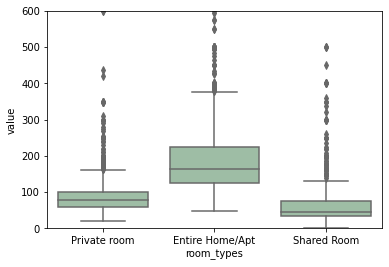

In [ ]:
# reshape the d dataframe suitable for statsmodels package 
df_room_type_combined1 = pd.melt(df_room_type_combined.reset_index(), id_vars=['index'], value_vars=["Private room", "Entire Home/Apt", "Shared Room"])

df_room_type_combined1.tail()

# replace column names
df_room_type_combined1.columns = ['index', 'room_types', 'value']
plt.ylim(ymin=0, ymax=600)

ax = sns.boxplot(x='room_types', y='value', data=df_room_type_combined1, color='#99c2a2')
# ax = sns.swarmplot(x='distance_levels', y="value", data=df_subway_combined1, color='#7d0013')
plt.show()

In [ ]:
# stats f_oneway functions takes the groups as input and returns ANOVA F and p value
fvalue, pvalue = stats.f_oneway(df_room_type_combined["Private room"], df_room_type_combined["Entire Home/Apt"], df_room_type_combined["Shared Room"])
pvalue ="{0:.50f}".format(pvalue)
print(fvalue, pvalue)

288.26552020661217 0.00000000000000000000000000000000000000000000000000


In [ ]:
# Ordinary Least Squares (OLS) model
model = ols('value ~ C(room_types)', data=df_room_type_combined1).fit()
anova_table = sm.stats.anova_lm(model, typ=2)
anova_table

,sum_sq,df,F,PR(>F)
C(room_types),1.067279e+07,2.0,288.26552,1.464906e-116
Residual,6.436652e+07,3477.0,NaN,NaN


##Neighbourhood Groups

In [ ]:
#We want to see the different Neighbourhood Groups in the dataset.
print(df_c_kaggle["neighbourhood_group"].unique())
df_c_kaggle = df_c_kaggle.drop(["Unnamed: 0"], axis=1)

['Brooklyn' 'Manhattan' 'Queens' 'Staten Island' 'Bronx']


In [ ]:
#We here divided our main dataset into the neighbour datasets.
df_manhattan = df_c_kaggle[df_c_kaggle["neighbourhood_group"] == "Manhattan"]
df_brooklyn = df_c_kaggle[df_c_kaggle["neighbourhood_group"] == "Brooklyn"]
df_bronx = df_c_kaggle[df_c_kaggle["neighbourhood_group"] == "Bronx"]
df_statenisland = df_c_kaggle[df_c_kaggle["neighbourhood_group"] == "Staten Island"]
df_queens = df_c_kaggle[df_c_kaggle["neighbourhood_group"] == "Queens"]

In [ ]:
#We reseted their index since they weren't in order.
df_manhattan.reset_index(drop=True, inplace=True)
df_brooklyn.reset_index(drop=True, inplace=True)
df_bronx.reset_index(drop=True, inplace=True)
df_statenisland.reset_index(drop=True, inplace=True)
df_queens.reset_index(drop=True, inplace=True)

In [ ]:
#Observing their sizes...
print(df_manhattan.shape)
print(df_brooklyn.shape)
print(df_bronx.shape)
print(df_statenisland.shape)
print(df_queens.shape)

(21661, 22)
(20104, 22)
(1091, 22)
(373, 22)
(5666, 22)


In [ ]:
#We concatenate these dataframes into one big dataframe with.
headers = ["Manhattan", "Brooklyn","Bronx","Staten Island","Queens"]
df_neighbours = [df_manhattan["price"],df_brooklyn["price"],df_bronx["price"],df_statenisland["price"],df_queens["price"]]
df_neighbours = pd.concat(df_neighbours, axis=1, keys= headers)
df_neighbours.tail()

,Manhattan,Brooklyn,Bronx,Staten Island,Queens
21656,200,NaN,NaN,NaN,NaN
21657,125,NaN,NaN,NaN,NaN
21658,115,NaN,NaN,NaN,NaN
21659,55,NaN,NaN,NaN,NaN
21660,90,NaN,NaN,NaN,NaN


In [ ]:
df_neighbours.head()

,Manhattan,Brooklyn,Bronx,Staten Island,Queens
0,225,149.0,40.0,70.0,130.0
1,150,89.0,45.0,36.0,70.0
2,80,60.0,90.0,37.0,140.0
3,200,89.0,105.0,37.0,79.0
4,79,140.0,90.0,36.0,350.0


In [ ]:
#We apply pd.melt function and obtain another dataframe which is more applicable for our tests.
df_neighbours1 = pd.melt(df_neighbours.reset_index(),id_vars=["index"],value_vars=["Manhattan","Brooklyn","Bronx","Staten Island","Queens"])
df_neighbours1.columns = ["index","neighbourhood_group","price"]
df_neighbours1.head()

,index,neighbourhood_group,price
0,0,Manhattan,225.0
1,1,Manhattan,150.0
2,2,Manhattan,80.0
3,3,Manhattan,200.0
4,4,Manhattan,79.0


###Box Plots of Prices of Neighbourhood Groups

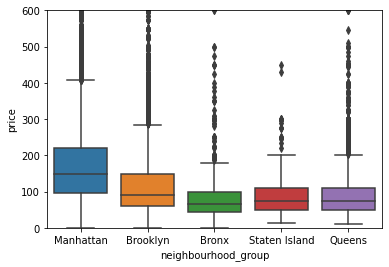

In [ ]:
#We plot our price distributions for each neihgbourhood groups.
plt.ylim(ymin = 0, ymax=600)
ax = sns.boxplot(x="neighbourhood_group",y="price",data = df_neighbours1)
plt.show()

###Statistical Test - ANOVA for Prices of Neighbourhood Groups

Hypothesis Test: We want to test whether there is significant differences in terms of price for different neighbourhood groups.

**Null Hypothesis ($H_0$)**: Means of price samples for all neighbourhood groups are same (e.g.  ci1  denotes 1st (subway_low that is lowest level) price sample).

H0:μci1=μci2=μci3 

**Alternative Hypothesis ($H_A$)**: Means of price samples for all neihgbours groups are not same (There is at least one difference between samples). 

HA:  Means  μci1,μci2,μci3  all are not same.

**Significance level**: As most of hypothesis tests assume significance level as 0.05, we are setting it as 0.05 for our test too.

In [ ]:
res = stat()
res.anova_stat(df=df_neighbours1, res_var='price', anova_model='price ~ C(neighbourhood_group)')
res.anova_summary

,df,sum_sq,mean_sq,F,PR(>F)
C(neighbourhood_group),4.0,7.959096e+07,1.989774e+07,354.994839,7.723724e-302
Residual,48890.0,2.740323e+09,5.605078e+04,NaN,NaN


**Interpreting results:**

> As p-value (PR(>F)) we obtained is smaller than the threshold significance level 0.05, we can conclude that means of price samples for all neighbourhood groups are not the same. Here, we reject the null hypothesis.

### Tukey's HSD (Honestly Dignificant Difference) Test

We decided to apply Tukey's HSD post hoc test since we rejected the null hypothesis on ANOVA and concluded that at least one of the means of price samples for all neighbourhood groups are different. To see which of those are different we perform a multiple pairwise comparison for each neighbourhood group samples to determine if significant difference exists between a set of means and determines where the difference exists. Honestly significant difference is shown when the pairwise difference between two means exceeds the value computed as:
HSD=q√(MS/n)

**Null Hypothesis ($H_0$)**: Means of price samples for both neighbourhood groups are same (e.g. ci1 denotes 1st price sample).

H0:μci1=μci2 

**Alternative Hypothesis ($H_A$)**: Means of price samples for both neighbourhood groups are not same. (There is a significant difference)

HA:  Means of μci1,μci2 are not same.

In [ ]:
# we will use bioinfokit (v1.0.3 or later) for performing tukey HSD test
# check documentation here https://github.com/reneshbedre/bioinfokit
# perform multiple pairwise comparison (Tukey's HSD)
# unequal sample size data, tukey_hsd uses Tukey-Kramer test
res = stat()
res.tukey_hsd(df=df_neighbours1, res_var='price', xfac_var='neighbourhood_group', anova_model='price ~ C(neighbourhood_group)')
res.tukey_summary

,group1,group2,Diff,Lower,Upper,q-value,p-value
0,Manhattan,Brooklyn,72.492606,66.167940,78.817272,44.217289,0.001000
1,Manhattan,Bronx,109.379022,89.340300,129.417743,21.057171,0.001000
2,Manhattan,Staten Island,82.063481,48.337480,115.789483,9.386876,0.001000
3,Manhattan,Queens,97.358165,87.721421,106.994908,38.974279,0.001000
4,Brooklyn,Bronx,36.886415,16.810519,56.962312,7.088062,0.001000
5,Brooklyn,Staten Island,9.570875,-24.177228,43.318977,1.094053,0.900000
6,Brooklyn,Queens,24.865558,15.151750,34.579367,9.875172,0.001000
7,Bronx,Staten Island,27.315541,-11.420533,66.051614,2.720384,0.304741
8,Bronx,Queens,12.020857,-9.331122,33.372837,2.171867,0.533779
9,Staten Island,Queens,15.294683,-19.227771,49.817137,1.709129,0.719473


**Interpreting results:**

> As p-value we obtained from the pairwise comparisons between Manhattan and Brooklyn, Manhattan and Bronx, Manhattan and Staten Island, Manhattan and Queens, Brooklyn and Bronx, Brooklyn and Queens is smaller than the threshold significance level 0.05 (p-value 0.001 denotes that p-value is less than 0.001),we can conclude that means of price samples for these neighbourhood groups  are not the same. Here, we reject the null hypothesis. 
For other pairs, we see that there does not seem to be a significant difference, so here, we can not reject null hypothesis.


## Nearest Subway Distances

In this part, using the Nearest Subway Distances in our main Data set, we divide the feature Nearest Subway Distances into 3 ordinal categories in order to apply hypothesis testing (ANOVA) and compare the mean prices of each of these categories to see if there is any difference of these 3 categories on price behaviour.

In [ ]:
df_c_kaggle_sortedby_dist_subway1 = df_c_kaggle.sort_values(by="nearest_subway_distance",inplace=False)

df_subway_low_dist = df_c_kaggle_sortedby_dist_subway1[:16298]

df_subway_low_dist = df_subway_low_dist.reset_index(drop=True)

df_subway_low_dist.shape
df_subway_low_dist.head()


,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,27284,21549898,"UWS Jewel, oval living room in a charming home...",6420489,Lorena,Manhattan,Upper West Side,40.77845,-73.98198,Entire home/apt,315,4,16,2019-05-31,0.84,1,7,161,0.000905,20,1.154550,1910,1404
1,36426,28963840,Cozy 2 Bedroom Home,22301628,Jayleen,Brooklyn,East New York,40.67454,-73.89652,Entire home/apt,120,2,15,2019-01-13,1.66,1,0,384,0.002370,48,5.145426,955,1179
2,2537,1308308,Renovated 2 Bedroom (Hells Kitchen) TIME SQUARE,7112116,Ty,Manhattan,Hell's Kitchen,40.76248,-73.98597,Entire home/apt,399,3,108,2019-06-22,1.51,2,351,346,0.002916,20,0.708372,2633,3196
3,36712,29181281,A Suite with breathtaking views of NYC !,145981682,Simi,Manhattan,Theater District,40.75982,-73.98418,Private room,999,1,12,2019-02-11,1.40,3,213,353,0.003195,21,0.283363,2302,3111
4,38283,30176919,Cali-Retro Duplex in Historic Greenpoint,6701890,Jenny,Brooklyn,Greenpoint,40.73128,-73.95439,Private room,95,7,1,2019-04-13,0.34,2,0,137,0.003282,25,1.171211,885,818


In [ ]:
df_c_kaggle_sortedby_dist_subway1 = df_c_kaggle.sort_values(by="nearest_subway_distance",inplace=False)

df_subway_med_dist = df_c_kaggle_sortedby_dist_subway1[16298:32596]

df_subway_med_dist = df_subway_med_dist.reset_index(drop=True)
df_subway_med_dist.head()
# df_subway_med_dist.shape

,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,42092,32681584,Artful UWS Penthouse with Balcony by Central Park,245314318,Arthouse Hotel,Manhattan,Upper West Side,40.78136,-73.97988,Private room,350,1,0,NaN,1.373221,10,282,192,0.286053,20,1.487670,1813,1186
1,1223,521806,Airy 1BR nice area Queens nr subway,2389494,Anya,Queens,Rego Park,40.72719,-73.86166,Entire home/apt,69,5,5,2019-05-17,0.100000,1,4,190,0.286055,46,1.409640,560,543
2,4216,2755909,Cozy sunny Apt in NYC,3447539,Nick,Manhattan,Washington Heights,40.84915,-73.93848,Private room,59,30,65,2019-06-06,1.330000,2,99,395,0.286057,14,1.634391,1662,1707
3,17469,13753375,2 Bedroom apartment in Prime Williamsburg!,1434340,Yana,Brooklyn,Williamsburg,40.70938,-73.95435,Entire home/apt,150,1,174,2019-06-27,4.840000,1,236,139,0.286071,25,1.295582,671,1280
4,3832,2310791,Old Brooklyn Charm,3689829,Lee,Brooklyn,Clinton Hill,40.68583,-73.96558,Entire home/apt,200,2,110,2019-06-24,1.730000,1,51,447,0.286086,27,1.766707,695,925


In [ ]:
df_subway_med_dist.head()


,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,42092,32681584,Artful UWS Penthouse with Balcony by Central Park,245314318,Arthouse Hotel,Manhattan,Upper West Side,40.78136,-73.97988,Private room,350,1,0,NaN,1.373221,10,282,192,0.286053,20,1.487670,1813,1186
1,1223,521806,Airy 1BR nice area Queens nr subway,2389494,Anya,Queens,Rego Park,40.72719,-73.86166,Entire home/apt,69,5,5,2019-05-17,0.100000,1,4,190,0.286055,46,1.409640,560,543
2,4216,2755909,Cozy sunny Apt in NYC,3447539,Nick,Manhattan,Washington Heights,40.84915,-73.93848,Private room,59,30,65,2019-06-06,1.330000,2,99,395,0.286057,14,1.634391,1662,1707
3,17469,13753375,2 Bedroom apartment in Prime Williamsburg!,1434340,Yana,Brooklyn,Williamsburg,40.70938,-73.95435,Entire home/apt,150,1,174,2019-06-27,4.840000,1,236,139,0.286071,25,1.295582,671,1280
4,3832,2310791,Old Brooklyn Charm,3689829,Lee,Brooklyn,Clinton Hill,40.68583,-73.96558,Entire home/apt,200,2,110,2019-06-24,1.730000,1,51,447,0.286086,27,1.766707,695,925


In [ ]:
df_subway_high_dist = df_c_kaggle_sortedby_dist_subway1[32596:]

df_subway_high_dist = df_subway_high_dist.reset_index(drop=True)
df_subway_high_dist.head()
# df_subway_high_dist.shape

,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,27232,21516443,Cozy bedroom in Williamsburg apartment home!,112966930,Kayla,Brooklyn,Williamsburg,40.71218,-73.96268,Private room,60,2,2,2017-11-08,0.10,1,0,138,0.587198,25,1.323225,966,859
1,35432,28108959,Sunny Prospect Park Studio,2153064,Justin,Brooklyn,Prospect-Lefferts Gardens,40.66021,-73.95982,Entire home/apt,100,3,18,2019-06-20,1.74,1,0,113,0.587219,27,1.204498,1396,1503
2,31324,24332080,Huge Bright Bedroom in Brooklyn Townhouse,62803,Eugenia,Brooklyn,Crown Heights,40.67004,-73.92207,Private room,54,6,6,2019-03-30,0.65,2,225,221,0.587219,47,4.546533,1636,1901
3,4635,3248526,Beautiful Comfortable Apt in North Manhattan,16430857,Aseel,Manhattan,Harlem,40.82524,-73.94186,Entire home/apt,78,5,13,2018-09-16,0.22,1,0,410,0.587239,16,2.421337,2389,2497
4,14627,11552402,Comfy NYC Studio 15 Min. To Midtown,60990988,Terrence,Manhattan,Harlem,40.81032,-73.95415,Entire home/apt,90,2,198,2019-06-19,4.87,1,39,397,0.587259,16,1.229597,2493,1998


In [ ]:
df_subway_med_dist.tail()
df_subway_high_dist.tail()
# df_subway_med_dist["room_type"].unique()




,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
16294,23460,18997371,Cozy Getaway,90104417,Sueann,Staten Island,Tottenville,40.50873,-74.23914,Entire home/apt,85,2,49,2019-07-01,2.080000,2,159,316,21.280746,81,1.292753,76,42
16295,1424,639199,"Beautiful 4BR/4BA Home, Staten Island, NY City.",1483081,Marina,Staten Island,Tottenville,40.50868,-74.23986,Entire home/apt,299,3,59,2019-07-08,0.820000,1,245,316,21.334121,81,1.251693,74,39
16296,45652,34888503,Charming town of Tottenville right outside NYC,962249,Dora,Staten Island,Tottenville,40.50943,-74.24442,Entire home/apt,70,3,1,2019-07-01,1.000000,1,128,316,21.607412,81,1.150732,65,113
16297,15278,12230928,Villa DiGioia visit NYC via SI,65806798,Michael J,Staten Island,Tottenville,40.50708,-74.24285,Private room,100,2,0,NaN,1.373221,1,365,316,21.643009,81,0.964569,55,48
16298,14119,10830083,Beautiful well kept private home!,56078939,Tony,Staten Island,Tottenville,40.49979,-74.24084,Private room,110,2,0,NaN,1.373221,1,364,316,21.972443,81,0.653211,44,37


In [ ]:
# df_subway_combined[]
# df_subway_combined["A"] =  df_subway_high_dist["nearest_subway_distance"]

df_subway_combined = [df_subway_low_dist["price"], df_subway_med_dist["price"],df_subway_high_dist["price"]]
headers = ["subway_low", "subway_med", "subway_high"]
df_subway_combined = pd.concat(df_subway_combined, axis=1, keys=headers)

df_subway_combined.tail()


,subway_low,subway_med,subway_high
16294,600.0,58.0,85
16295,80.0,120.0,299
16296,175.0,90.0,70
16297,55.0,95.0,100
16298,NaN,NaN,110


In [ ]:
df_subway_combined = df_subway_combined.drop([16298])


In [ ]:
df_subway_combined.tail()

,subway_low,subway_med,subway_high
16293,800.0,50.0,275
16294,600.0,58.0,85
16295,80.0,120.0,299
16296,175.0,90.0,70
16297,55.0,95.0,100


### Box plots of Prices of Nearest Subway Distance Levels 


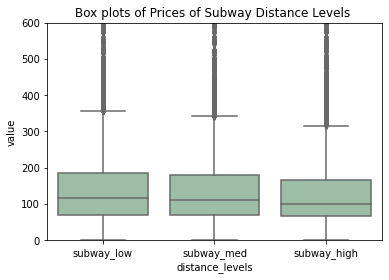

In [ ]:
# reshape the d dataframe suitable for statsmodels package 
df_subway_combined1 = pd.melt(df_subway_combined.reset_index(), id_vars=['index'], value_vars=["subway_low", "subway_med", "subway_high"])

df_subway_combined1.tail()

# replace column names
df_subway_combined1.columns = ['index', 'distance_levels', 'value']
plt.ylim(ymin=0, ymax=600)
plt.title("Box plots of Prices of Subway Distance Levels ")
ax = sns.boxplot(x='distance_levels', y='value', data=df_subway_combined1, color='#99c2a2')
# ax = sns.swarmplot(x='distance_levels', y="value", data=df_subway_combined1, color='#7d0013')
plt.show()

Above, we plotted the box plots of each distance level's prices. We see that there seems to be quite a difference between subway_low and subway_high, subway_med and subway_high. There is some difference between subway_low and subway_medium but it doesn't seem to be a significant one.

In [ ]:
# stats f_oneway functions takes the groups as input and returns ANOVA F and p value
fvalue, pvalue = stats.f_oneway(df_subway_combined["subway_low"], df_subway_combined["subway_med"], df_subway_combined["subway_high"])
pvalue ="{0:.50f}".format(pvalue)
print(fvalue, pvalue)


20.344310566064564 0.00000000147316944252902446393696247003328794744625


In [ ]:
# Ordinary Least Squares (OLS) model
model = ols('value ~ C(distance_levels)', data=df_subway_combined1).fit()
anova_table = sm.stats.anova_lm(model, typ=2)
anova_table

,sum_sq,df,F,PR(>F)
C(distance_levels),2.344868e+06,2.0,20.344311,1.473169e-09
Residual,2.817567e+09,48891.0,NaN,NaN


### Statistical Test - ANOVA for Prices of Nearest Subway Distance Levels

Hypothesis Test: We want to test whether there is significant differences in terms of price for different nearest subway distance levels.

**Null Hypothesis ($H_0$)**: Means of price samples for all nearest subway distance levels are same (e.g.  ci1  denotes 1st (subway_low that is lowest level) price sample).

H0:μci1=μci2=μci3 

**Alternative Hypothesis ($H_A$)**: Means of price samples for all nearest subway distance levels are not same (There is at least one difference between samples). 

HA:  Means  μci1,μci2,μci3  all are not same.

**Significance level**: As most of hypothesis tests assume significance level as 0.05, we are setting it as 0.05 for our test too.

Since we want to test 3 samples simultaneously, ANOVA is a test that we can apply here. Below, we introduce our samples to ANOVA test.

In [ ]:
res = stat()
res.anova_stat(df=df_subway_combined1, res_var='value', anova_model='value ~ C(distance_levels)')
res.anova_summary

,df,sum_sq,mean_sq,F,PR(>F)
C(distance_levels),2.0,2.344868e+06,1.172434e+06,20.344311,1.473169e-09
Residual,48891.0,2.817567e+09,5.762957e+04,NaN,NaN


**Interpreting results:**

> As p-value (PR(>F)) we obtained is smaller than the threshold significance level 0.05, we can conclude that means of price samples for all nearest subway distance levels are not the same. Here, we reject the null hypothesis.

### Tukey's HSD (Honestly Dignificant Difference) Test

We decided to apply Tukey's HSD post hoc test since we rejected the null hypothesis on ANOVA and concluded that at least one of the means of price samples for all nearest subway distance levels are different. To see which of those are different we perform a multiple pairwise comparison for each distance level samples to determine if significant difference exists between a set of means and determines where the difference exists. Honestly significant difference is shown when the pairwise difference between two means exceeds the value computed as:
HSD=q√(MS/n)

**Null Hypothesis ($H_0$)**: Means of price samples for both nearest subway distance levels are same (e.g. ci1 denotes 1st price sample).

H0:μci1=μci2 

**Alternative Hypothesis ($H_A$)**: Means of price samples for both nearest subway distance levels are not same. (There is a significant difference)

HA:  Means of μci1,μci2 are not same.

In [ ]:
# we will use bioinfokit (v1.0.3 or later) for performing tukey HSD test
# check documentation here https://github.com/reneshbedre/bioinfokit
# perform multiple pairwise comparison (Tukey's HSD)
# unequal sample size data, tukey_hsd uses Tukey-Kramer test
res = stat()
res.tukey_hsd(df=df_subway_combined1, res_var='value', xfac_var='distance_levels', anova_model='value ~ C(distance_levels)')
res.tukey_summary

,group1,group2,Diff,Lower,Upper,q-value,p-value
0,subway_low,subway_med,3.583139,-2.649711,9.815989,1.905496,0.370104
1,subway_low,subway_high,16.150632,9.917782,22.383482,8.588830,0.001000
2,subway_med,subway_high,12.567493,6.334643,18.800343,6.683334,0.001000


**Interpreting results:**

> As p-value we obtained from the pairwise comparisons between subway_low	and subway_high, subway_med and	subway_high is smaller than the threshold significance level 0.05 (p-value 0.001 denotes that p-value is less than 0.001),we can conclude that means of price samples for these levels are not the same. Here, we reject the null hypothesis. 
For subway_low vs	subway_med, we see that there does not seem to be a significant difference, so here, we can not reject null hypothesis.


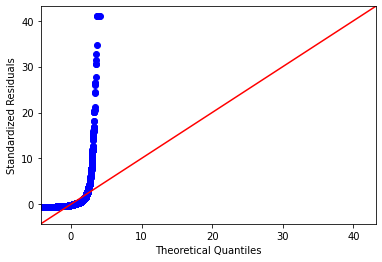

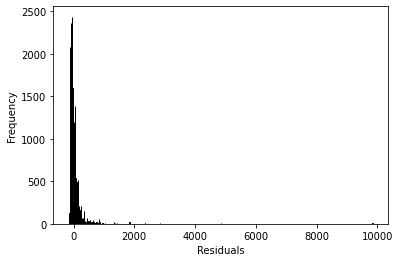

In [ ]:
# res.anova_std_residuals are standardized residuals obtained from ANOVA (check above)
sm.qqplot(res.anova_std_residuals, line='45')
plt.xlabel("Theoretical Quantiles")
plt.ylabel("Standardized Residuals")
plt.show()

# histogram
plt.hist(res.anova_model_out.resid, bins='auto', histtype='bar', ec='k') 
plt.xlabel("Residuals")
plt.ylabel('Frequency')
plt.show()

In [ ]:
res = stat()
res.levene(df=df_subway_combined1, res_var='value', xfac_var='distance_levels')
res.levene_summary

,Parameter,Value
0,Test statistics (W),7.7023
1,Degrees of freedom (Df),2.0000
2,p value,0.0005


In [ ]:
w, pvalue = stats.shapiro(model.resid)
print(w, pvalue)

0.3007209300994873 0.0


/usr/local/lib/python3.7/dist-packages/scipy/stats/morestats.py:1676: UserWarning:

p-value may not be accurate for N > 5000.



In [ ]:
from bioinfokit.analys import stat 
res = stat()
res.bartlett(df=df_subway_combined1, res_var='value', xfac_var='distance_levels')
res.bartlett_summary


,Parameter,Value
0,Test statistics (T),198.3458
1,Degrees of freedom (Df),2.0000
2,p value,0.0000


## Nearest POI Distances

In this part, using the Nearest POI Distances in our main Data set, we divide the feature Nearest POI Distances into 3 ordinal categories in order to apply hypothesis testing (ANOVA) and compare the mean prices of each of these categories to see if there is any difference of these 3 categories on price behaviour.

In [ ]:
df_c_kaggle_sortedby_dist_poi= df_c_kaggle.sort_values(by="nearest_poi_distance",inplace=False)

df_c_kaggle_sortedby_dist_poi1 = pd.DataFrame(df_c_kaggle_sortedby_dist_poi["nearest_poi_distance"])
df_c_kaggle_sortedby_dist_poi1 = pd.DataFrame(index = range(length(df_c_kaggle_sortedby_dist_poi["nearest_poi_distance"]),(df_c_kaggle_sortedby_dist_poi))

df_c_kaggle_sortedby_dist_poi1.head()

SyntaxError: ignored

In [ ]:
df_c_kaggle_sortedby_dist_poi1 = df_c_kaggle.sort_values(by="nearest_poi_distance",inplace=False)

df_poi_low_dist = df_c_kaggle_sortedby_dist_poi1[:16298]

df_poi_low_dist = df_poi_low_dist.reset_index(drop=True)

df_poi_low_dist.shape
df_poi_low_dist.head()

,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,22209,17892114,Walk to CENTRAL PARK and TIME SQUARE!!!!,6716330,Chris,Manhattan,Midtown,40.76811,-73.98181,Private room,95,3,62,2019-06-13,2.390000,3,86,93,0.018223,20,0.009502,2189,2165
1,36074,28663593,WILLIAMSBURG LUXURY BUILDING (BEST LOCATION),216091157,Sofia,Brooklyn,Greenpoint,40.72108,-73.95215,Entire home/apt,200,5,5,2018-12-09,0.520000,1,0,136,0.386503,25,0.024560,918,1049
2,26617,21175139,"Manhattan, double size sofa bed no deposit",7055854,Diane,Manhattan,Harlem,40.80323,-73.94253,Private room,1500,5,3,2017-10-23,0.140000,5,219,461,0.517023,16,0.028477,2422,3330
3,48411,36241854,Union Square Private Apt,272596313,David Bruce,Manhattan,Gramercy,40.73580,-73.99074,Entire home/apt,150,7,0,NaN,1.373221,1,29,378,0.018744,23,0.035120,2380,3969
4,29216,22421636,Cozy Apartment across Astoria Park,35518413,Suhel,Queens,Ditmars Steinway,40.77692,-73.92385,Entire home/apt,130,1,93,2019-07-01,5.010000,2,279,303,1.144485,26,0.038007,258,472


In [ ]:
df_c_kaggle_sortedby_dist_poi1 = df_c_kaggle.sort_values(by="nearest_poi_distance",inplace=False)

df_poi_med_dist = df_c_kaggle_sortedby_dist_poi1[16298:32596]

df_poi_med_dist = df_poi_med_dist.reset_index(drop=True)
df_poi_med_dist.head()
# df_poi_med_dist.shape

,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,34063,26989977,Beautiful Clinton Hill 1-BR in luxury building,24822059,Jessica,Brooklyn,Clinton Hill,40.68214,-73.96536,Entire home/apt,119,6,2,2018-08-29,0.180000,1,0,447,0.131133,27,1.357590,745,868
1,1927,848174,1BR East Village Apt - Entire Apt.,1468667,Darragh,Manhattan,East Village,40.73031,-73.98426,Entire home/apt,190,1,0,NaN,1.373221,1,0,382,0.292831,22,1.357591,2049,2892
2,37902,29982568,Home 家,213781715,Anting,Brooklyn,Greenpoint,40.73306,-73.95353,Private room,119,1,0,NaN,1.373221,33,365,137,0.213025,25,1.357593,962,763
3,9811,7547481,Adorable Brooklyn Apartment,9646150,Lila (Eli),Brooklyn,Prospect-Lefferts Gardens,40.65845,-73.96064,Private room,60,1,140,2019-06-24,4.000000,2,40,113,0.381479,27,1.357643,1470,1415
4,32626,25625417,The Palace of Perhaps (Bushwick / Ridgewood),21061846,Briana,Queens,Ridgewood,40.69943,-73.90712,Private room,40,2,13,2019-06-28,0.990000,1,0,233,0.389664,47,1.357727,1060,1092


In [ ]:
df_poi_high_dist = df_c_kaggle_sortedby_dist_poi1[32596:]

df_poi_high_dist = df_poi_high_dist.reset_index(drop=True)
df_poi_high_dist.head()
# df_poi_high_dist.shape

,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,10910,8412352,Apt on President St & Kingston Ave,44314131,Raphael,Brooklyn,Crown Heights,40.66852,-73.94250,Entire home/apt,160,1,1,2015-10-06,0.020000,1,0,135,0.110622,30,2.441357,778,1322
1,33137,26139678,Private cozy room in perfect UWS,18497228,현선,Manhattan,Morningside Heights,40.80485,-73.96534,Private room,1200,60,0,NaN,1.373221,1,365,166,0.335502,19,2.441388,1255,857
2,23983,19342731,Private Room Avail. Now- Aug 20 Clinton/BedStuy,132958806,Shannon,Brooklyn,Bedford-Stuyvesant,40.69140,-73.95993,Private room,45,10,0,NaN,1.373221,1,0,69,0.279081,27,2.441543,1133,1202
3,39999,31069942,Cozy room in a area with everything.female onl...,110179329,Nashwa,Brooklyn,Bay Ridge,40.63340,-74.02120,Private room,70,1,0,NaN,1.373221,1,342,309,0.253010,34,2.441553,798,679
4,21057,16692402,2BEDS or DOUBLE BED (KINGSIZE) / PRIVATE BATHROOM,32107612,Eugon And David,Brooklyn,Bushwick,40.68886,-73.91906,Private room,95,5,65,2019-06-29,2.180000,1,60,74,0.339744,47,2.441593,1332,1865


In [ ]:
df_poi_med_dist.tail()
df_poi_high_dist.tail()

,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
16294,16396,13170159,Brooklyn Brand New Studio,62535444,Alex,Brooklyn,Manhattan Beach,40.57867,-73.95227,Entire home/apt,99,1,41,2019-07-04,1.10,2,363,327,0.888303,30,7.677471,222,326
16295,32500,25476912,3rd floor: Charming 2 BR guest suite with balcony,38675275,Margaret,Queens,Belle Harbor,40.57592,-73.84823,Private room,200,2,4,2019-06-16,1.28,2,332,183,1.204691,95,7.830107,47,30
16296,25801,20641793,Modern Studio 1 block away from the beach,725286,Michael,Brooklyn,Brighton Beach,40.57688,-73.95308,Entire home/apt,130,3,22,2019-06-20,0.99,1,134,327,1.077473,30,7.884861,200,323
16297,40675,31557309,"IDEAL Beach Bungalow in BelleHarbor, Rockaway!",40025069,Briana,Queens,Belle Harbor,40.57518,-73.84558,Entire home/apt,97,2,2,2019-06-30,2.00,1,52,183,1.059667,95,7.905840,66,36
16298,34750,27549628,Charming two-bedroom suite in Rockaway Beach,38675275,Margaret,Queens,Belle Harbor,40.57491,-73.84962,Entire home/apt,200,1,32,2019-06-24,3.02,2,324,183,1.361468,95,7.948108,41,33


In [ ]:
df_poi_combined = [df_poi_low_dist["price"], df_poi_med_dist["price"],df_poi_high_dist["price"]]
headers = ["poi_low", "poi_med", "poi_high"]
df_poi_combined = pd.concat(df_poi_combined, axis=1, keys=headers)

df_poi_combined.tail()

,poi_low,poi_med,poi_high
16294,100.0,140.0,99
16295,230.0,47.0,200
16296,200.0,200.0,130
16297,135.0,40.0,97
16298,NaN,NaN,200


In [ ]:
# df_poi_combined = df_poi_combined.drop([16298])


### Box plots of Prices of Nearest POI Distance Levels



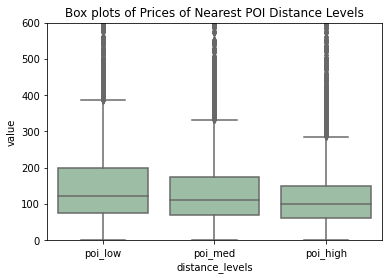

In [ ]:
# reshape the d dataframe suitable for statsmodels package 
df_poi_combined1 = pd.melt(df_poi_combined.reset_index(), id_vars=['index'], value_vars=["poi_low", "poi_med", "poi_high"])

df_poi_combined1.tail()

# replace column names
df_poi_combined1.columns = ['index', 'distance_levels', 'value']
plt.ylim(ymin=0, ymax=600)
plt.title("Box plots of Prices of Nearest POI Distance Levels")
ax = sns.boxplot(x='distance_levels', y='value', data=df_poi_combined1, color='#99c2a2')
# ax = sns.swarmplot(x='distance_levels', y="value", data=df_poi_combined1, color='#7d0013')
plt.show()

Above, we plotted the box plots of each distance level's prices. We see that there seems to be quite a difference between poi_low, poi_med and poi_high, all 3 seem to be different.

In [ ]:
# stats f_oneway functions takes the groups as input and returns ANOVA F and p value
fvalue, pvalue = stats.f_oneway(df_poi_combined["poi_low"], df_poi_combined["poi_med"], df_poi_combined["poi_high"])
pvalue ="{0:.50f}".format(pvalue)
print(fvalue, pvalue)

nan nan


In [ ]:
# Ordinary Least Squares (OLS) model
model = ols('value ~ C(distance_levels)', data=df_poi_combined1).fit()
anova_table = sm.stats.anova_lm(model, typ=2)
anova_table

,sum_sq,df,F,PR(>F)
C(distance_levels),7.844182e+06,2.0,68.19137,2.667428e-30
Residual,2.812070e+09,48892.0,NaN,NaN


### Statistical Test - ANOVA for Prices of Nearest POI Distance Levels

Hypothesis Test: We want to test whether there is significant differences in terms of price for different nearest POI distance levels.

**Null Hypothesis ($H_0$)**: Means of price samples for all nearest POI distance levels are same (e.g.  ci1  denotes 1st (poi_low that is lowest level) price sample).

H0:μci1=μci2=μci3 

**Alternative Hypothesis ($H_A$)**: Means of price samples for all nearest poi distance levels are not same (There is at least one difference between samples). 

HA:  Means  μci1,μci2,μci3  all are not same.

**Significance level**: As most of hypothesis tests assume significance level as 0.05, we are setting it as 0.05 for our test too.

Since we want to test 3 samples simultaneously, ANOVA is a test that we can apply here. Below, we introduce our samples to ANOVA test.

In [ ]:
res = stat()
res.anova_stat(df=df_poi_combined1, res_var='value', anova_model='value ~ C(distance_levels)')
res.anova_summary

,df,sum_sq,mean_sq,F,PR(>F)
C(distance_levels),2.0,7.844182e+06,3.922091e+06,68.19137,2.667428e-30
Residual,48892.0,2.812070e+09,5.751595e+04,NaN,NaN


**Interpreting results:**

> As p-value (PR(>F)) we obtained is smaller than the threshold significance level 0.05, we can conclude that means of price samples for all nearest POI distance levels are not the same. Hence, we reject the null hypothesis.

### Tukey's HSD (Honestly Significant Difference) Test

We decided to apply Tukey's HSD post hoc test since we rejected the null hypothesis on ANOVA and concluded that at least one of the means of price samples for all nearest POI distance levels are different. To see which of those are different we perform a multiple pairwise comparison for each distance level samples to determine if significant difference exists between a set of means and determine where the difference exists. Honestly significant difference is shown when the pairwise difference between two means exceeds the value computed as:
HSD=q√(MS/n)

**Null Hypothesis ($H_0$)**: Means of price samples for both nearest POI distance levels are same (e.g. ci1 denotes 1st price sample).

H0:μci1=μci2 

**Alternative Hypothesis ($H_A$)**: Means of price samples for both nearest POI distance levels are not same. (There is a significant difference)

HA:  Means of μci1,μci2 are not same.

In [ ]:
# we will use bioinfokit (v1.0.3 or later) for performing tukey HSD test
# check documentation here https://github.com/reneshbedre/bioinfokit
# perform multiple pairwise comparison (Tukey's HSD)
# unequal sample size data, tukey_hsd uses Tukey-Kramer test
res = stat()
res.tukey_hsd(df=df_poi_combined1, res_var='value', xfac_var='distance_levels', anova_model='value ~ C(distance_levels)')
res.tukey_summary

,group1,group2,Diff,Lower,Upper,q-value,p-value
0,poi_low,poi_med,12.340287,6.113584,18.566990,6.568985,0.001
1,poi_low,poi_high,30.821898,24.595290,37.048505,16.407373,0.001
2,poi_med,poi_high,18.481610,12.255003,24.708218,9.838287,0.001


**Interpreting results:**

> As p-value we obtained from the pairwise comparisons between all pairs are smaller than the threshold significance level 0.05 (p-value 0.001 denotes that p-value is less than 0.001), we can conclude that means of price samples for these levels are not the same. Hence, we reject the null hypothesis. With lower nearest distance to a poi location the more likely to have high house prices.



All these distance levels seem to be having different prices than each other



##Number of Felonies

In [ ]:
df_c_kaggle.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.210000,6,365,108,0.465043,28,1.554023,374,483
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.380000,2,355,59,0.093298,21,0.516611,2068,3243
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,1.373221,1,365,168,0.586601,16,0.621381,2204,3230
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.640000,1,194,69,0.417059,27,1.772545,1242,1188
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.100000,1,0,449,0.388443,16,0.560944,2342,3105


[]

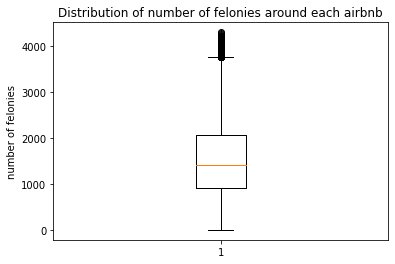

In [ ]:
#Lets see the distribution of number of felonies.
plt.title("Distribution of number of felonies around each airbnb")
plt.boxplot(df_c_kaggle["number_of_felonies"])
plt.ylabel("number of felonies")
plt.plot()

In [ ]:
df_felonies = df_c_kaggle.sort_values(by="number_of_felonies",inplace=False)
df_felonies.reset_index(drop=True,inplace=True)
df_felonies.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,36001911,Spectacular Views of NYC - 54th Floor Corner Apt,89394733,Alan And Beckie,Manhattan,Chelsea,40.75003,-74.01455,Entire home/apt,250,90,0,NaN,1.373221,1,244,425,4.249081,24,6.743549,0,0
1,27301638,Camp Rockaway,200754542,Kent,Queens,Breezy Point,40.56568,-73.87009,Private room,195,1,1,2018-08-25,0.090000,2,59,458,12.191277,65,0.275260,0,0
2,36417725,Ocenfront Glamping in Queens,273672846,Hectavious,Queens,Breezy Point,40.56546,-73.86968,Private room,250,1,0,NaN,1.373221,1,82,458,12.216253,65,0.313459,0,0
3,26703677,Camp Rockaway,200754542,Kent,Queens,Breezy Point,40.56605,-73.86994,Private room,195,1,4,2019-06-15,0.350000,2,160,458,12.150349,65,0.246359,0,0
4,34014834,Beautiful colonial near Belmont Race \nTract,256505094,Cederna,Queens,Cambria Heights,40.69955,-73.72247,Entire home/apt,180,1,0,NaN,1.373221,1,83,54,10.975606,60,5.847664,0,3


In [ ]:
df_felonies_low = df_felonies[:16298]
df_felonies_low.reset_index(drop=True,inplace=True)
df_felonies_mid = df_felonies[16298:32596]
df_felonies_mid.reset_index(drop=True,inplace=True)
df_felonies_high = df_felonies[32596:]
df_felonies_high.reset_index(drop=True,inplace=True)

In [ ]:
df_felonies_low.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,36001911,Spectacular Views of NYC - 54th Floor Corner Apt,89394733,Alan And Beckie,Manhattan,Chelsea,40.75003,-74.01455,Entire home/apt,250,90,0,NaN,1.373221,1,244,425,4.249081,24,6.743549,0,0
1,27301638,Camp Rockaway,200754542,Kent,Queens,Breezy Point,40.56568,-73.87009,Private room,195,1,1,2018-08-25,0.090000,2,59,458,12.191277,65,0.275260,0,0
2,36417725,Ocenfront Glamping in Queens,273672846,Hectavious,Queens,Breezy Point,40.56546,-73.86968,Private room,250,1,0,NaN,1.373221,1,82,458,12.216253,65,0.313459,0,0
3,26703677,Camp Rockaway,200754542,Kent,Queens,Breezy Point,40.56605,-73.86994,Private room,195,1,4,2019-06-15,0.350000,2,160,458,12.150349,65,0.246359,0,0
4,34014834,Beautiful colonial near Belmont Race \nTract,256505094,Cederna,Queens,Cambria Heights,40.69955,-73.72247,Entire home/apt,180,1,0,NaN,1.373221,1,83,54,10.975606,60,5.847664,0,3


In [ ]:
df_felonies_mid.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,6909447,Cozy & perfectly located Studio,36207962,Ariel,Manhattan,Upper West Side,40.78267,-73.97661,Entire home/apt,150,3,13,2015-11-28,0.260000,1,0,85,0.664680,20,1.683453,1085,1093
1,23965460,Cleo's Royale,157141199,Adeola,Manhattan,Inwood,40.86058,-73.92740,Private room,70,5,5,2019-05-24,0.410000,2,90,430,0.545843,13,1.294594,1266,1093
2,9902263,Upper West Side furnished studio,2350080,Yiwei,Manhattan,Upper West Side,40.80040,-73.96849,Entire home/apt,120,9,0,NaN,1.373221,1,0,158,0.106424,19,1.961284,1808,1093
3,19414323,Gorgeous bedroom in the Heart of Bushwick!,10457196,Richard,Queens,Ridgewood,40.70234,-73.90815,Private room,49,6,12,2019-05-20,0.490000,11,65,233,0.080184,47,1.029811,1007,1093
4,3944200,A Safe & Pleasant Time in NYC,20438402,Geoff & Aurelia,Manhattan,East Harlem,40.79508,-73.93256,Entire home/apt,195,3,25,2018-11-05,0.430000,3,0,467,1.092022,18,1.219242,1164,1093


In [ ]:
df_felonies_high.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,nearest_subway_indices,nearest_subway_distance,nearest_poi_indices,nearest_poi_distance,number_of_crimes,number_of_felonies
0,35005793,Sonder | The Nash | Bold 1BR + Rooftop,219517861,Sonder (NYC),Manhattan,Murray Hill,40.74899,-73.97541,Entire home/apt,200,29,0,NaN,1.373221,327,360,203,0.276409,21,1.138424,1793,1803
1,21014919,Spacious Private Bedroom in Northern Manhattan!,29248621,Chelsea,Manhattan,Washington Heights,40.84444,-73.93554,Private room,50,5,5,2018-04-01,0.290000,1,0,177,0.586092,14,2.084004,2148,1803
2,7560654,Beautiful 1BR in upper Manhattan- close to sub...,22863142,Sarah And Mike,Manhattan,Washington Heights,40.83353,-73.94393,Private room,110,4,45,2019-06-17,2.230000,1,59,156,0.098689,16,3.343232,1862,1803
3,4031809,Prewar classic NYC apartment.,20902552,Miquel,Manhattan,Washington Heights,40.83456,-73.94344,Private room,16,14,0,NaN,1.373221,1,0,156,0.134866,16,3.456630,1765,1803
4,34602589,Prime Location near Central Park and Museum Mile.,232863817,Higuemota,Manhattan,Upper East Side,40.78040,-73.94556,Private room,99,2,0,NaN,1.373221,1,146,472,0.444782,16,2.573923,1527,1803


In [ ]:
df_felonies_combined = [df_felonies_low["price"], df_felonies_mid["price"],df_felonies_high["price"]]
headers = ["felonies_low", "felonies_med", "felonies_high"]
df_felonies_combined = pd.concat(df_felonies_combined, axis=1, keys=headers)

df_felonies_combined.tail()

,felonies_low,felonies_med,felonies_high
16294,45.0,199.0,399
16295,199.0,70.0,600
16296,250.0,295.0,343
16297,60.0,50.0,105
16298,NaN,NaN,159


In [ ]:
df_felonies_combined.drop([16298],inplace = True)

In [ ]:
df_felonies_combined.tail()

,felonies_low,felonies_med,felonies_high
16293,350.0,45.0,115
16294,45.0,199.0,399
16295,199.0,70.0,600
16296,250.0,295.0,343
16297,60.0,50.0,105


###Box Plots of Price of Felony Number Levels

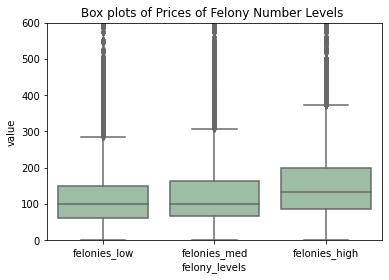

In [ ]:
# reshape the d dataframe suitable for statsmodels package 
df_felonies_combined1 = pd.melt(df_felonies_combined.reset_index(), id_vars=['index'], value_vars=["felonies_low", "felonies_med", "felonies_high"])

df_felonies_combined1.tail()

# replace column names
df_felonies_combined1.columns = ['index', 'felony_levels', 'value']
plt.ylim(ymin=0, ymax=600)
plt.title("Box plots of Prices of Felony Number Levels ")
ax = sns.boxplot(x='felony_levels', y='value', data=df_felonies_combined1, color='#99c2a2')
# ax = sns.swarmplot(x='distance_levels', y="value", data=df_subway_combined1, color='#7d0013')
plt.show()

In [ ]:
# Ordinary Least Squares (OLS) model
model = ols('value ~ C(felony_levels)', data=df_felonies_combined1).fit()
anova_table = sm.stats.anova_lm(model, typ=2)
anova_table

,sum_sq,df,F,PR(>F)
C(felony_levels),1.935517e+07,2.0,168.94728,7.577277e-74
Residual,2.800559e+09,48891.0,NaN,NaN


###Statistical Test - ANOVA for Prices of Felony Levels

Hypothesis Test: We want to test whether there is significant differences in terms of price for different felony levels.

**Null Hypothesis ($H_0$)**: Means of price samples for all felony levels are same (e.g.  ci1  denotes 1st (subway_low that is lowest level) price sample).

H0:μci1=μci2=μci3 

**Alternative Hypothesis ($H_A$)**: Means of price samples for all felony levels are not same (There is at least one difference between samples). 

HA:  Means  μci1,μci2,μci3  all are not same.

**Significance level**: As most of hypothesis tests assume significance level as 0.05, we are setting it as 0.05 for our test too.

In [ ]:
res = stat()
res.anova_stat(df=df_felonies_combined1, res_var='value', anova_model='value ~ C(felony_levels)')
res.anova_summary

,df,sum_sq,mean_sq,F,PR(>F)
C(felony_levels),2.0,1.935517e+07,9.677584e+06,168.94728,7.577277e-74
Residual,48891.0,2.800559e+09,5.728168e+04,NaN,NaN


**Interpreting results:**

> As p-value (PR(>F)) we obtained is smaller than the threshold significance level 0.05, we can conclude that means of price samples for all felony levels are not the same. Here, we reject the null hypothesis.

### Tukey's HSD (Honestly Dignificant Difference) Test

We decided to apply Tukey's HSD post hoc test since we rejected the null hypothesis on ANOVA and concluded that at least one of the means of price samples for all felony levels are different. To see which of those are different we perform a multiple pairwise comparison for each distance level samples to determine if significant difference exists between a set of means and determines where the difference exists. Honestly significant difference is shown when the pairwise difference between two means exceeds the value computed as:
HSD=q√(MS/n)

**Null Hypothesis ($H_0$)**: Means of price samples for both felony levels are same (e.g. ci1 denotes 1st price sample).

H0:μci1=μci2 

**Alternative Hypothesis ($H_A$)**: Means of price samples for both felony levels are not same. (There is a significant difference)

HA:  Means of μci1,μci2 are not same.

In [ ]:
# we will use bioinfokit (v1.0.3 or later) for performing tukey HSD test
# check documentation here https://github.com/reneshbedre/bioinfokit
# perform multiple pairwise comparison (Tukey's HSD)
# unequal sample size data, tukey_hsd uses Tukey-Kramer test
res = stat()
res.tukey_hsd(df=df_felonies_combined1, res_var='value', xfac_var='felony_levels', anova_model='value ~ C(felony_levels)')
res.tukey_summary

,group1,group2,Diff,Lower,Upper,q-value,p-value
0,felonies_low,felonies_med,8.631611,2.417602,14.845621,4.604168,0.003249
1,felonies_low,felonies_high,45.854829,39.640820,52.068838,24.459319,0.001000
2,felonies_med,felonies_high,37.223218,31.009208,43.437227,19.855151,0.001000


**Interpreting results:**

> As p-value we obtained from the pairwise comparisons between felonies_low	and felonies_high, felonies_med and	felonies_high, felonies_low and felonies_med is smaller than the threshold significance level 0.05 (p-value 0.001 denotes that p-value is less than 0.001),we can conclude that means of price samples for these levels are not the same. Here, we reject the null hypothesis.